# 1. Generative Adversarial Networks for Image Generation

# Introduction

Hi folks how you doing? I hope you doing great. well friends I have **a good and a bad news** for you. *Oh! What kind of news you may have?* Well the good news is; there is a secrete party is going on tonight in my neighbourhood and I think you may want to check out some cool things around there. *So what's the bad news dude?* Well the bad news is; the entry is restricted to **invited guests** only! WHAT?? If the party is only for the invited guests; why the hell you are telling us about it; you want to feel us jealous? No! My dear friends, I have a trick to get you entry passes which will let you in the party! What do you think guys? Are you in for it or not.

Well your first thoughts would be; *how the hell I will get you the entry passes?* Well the answer is pretty simple; **I will generate a fake one for you?** What? The fake one! Yes you hear it right. *But the guards at the entry will recognize the fake one so what will you do?* Well in that case I will generate another one for you. And this time it will look different than the previous one! But this time it will be based on the feedback of the guards. If guards again able to recognize it I will keep generating the fake tickets on the basis of your feedbacks and I guarantee you, after sometime I will generate an exact same replica of the original ticket on the basis of guards feedback. *Looks cool ha!!*

What do you think? Is it possible? Well the answer is yes hundred percent possible! But How? Well **Welcome to the world of Generative Adversarial Networks** Guys.

# 1.1 GAN Overview

The example I have used here is a typical case of a generative adversarial network in short **GAN**. It is a logical architecture which consist of a fake data Generator (Me in the above example); fake data (Our party tickets); real data (Real entry passes); and a Discriminator (Guards at the entry). So let’s see how the architecture of GAN looks like;

<img src='GAN_1.PNG'>

GANs are generative models devised by Goodfellow et al. in 2014. In a GAN setup, there are two differentiable functions, represented by neural networks (in most cases), are locked in a game. The two players (the generator and the discriminator) have different roles in this framework.
The generator tries to produce data that come from some probability distribution. That would be you trying to reproduce the party’s tickets.

The discriminator acts like a judge. It gets to decide if the input comes from the generator or from the true training set. That would be the party’s security guards comparing your fake ticket with the true ticket to find flaws in your design.
In summary, the game follows with:

- The generator trying to maximize the probability of making the discriminator mistakes its inputs as real.
- And the discriminator guiding the generator to produce more realistic images.

In the perfect equilibrium, the generator would capture the general training data distribution. As a result, the discriminator would be always unsure of whether its inputs are real or not.
So far GANs have been primarily applied to modelling natural images. They are now producing excellent results in image generation tasks, generating images that are significantly sharper than those trained using other leading generative methods based on maximum likelihood training objectives. Here are some examples of images generated by GANs:

<img src='GAN_2.png'>
*image source: http://torch.ch/blog/2015/11/13/gan.html*

Or GAN can be used to convert intensity images (Gray images) into colour images like this;

<img src='GAN_3.png'>
*image source: https://richzhang.github.io/colorization/*

# 1.2 Implementation of GAN

For simplicity and better understanding of our concepts underlying GAN, we will implement a simple GAN architecture for small image size dataset.

We will require some key ingredients to make this delicious recipe;

1. Real data (Actual Image dataset).
2. Random data (Input) generation for Generator network.
3. Generator network for generation of fake data. 
4. Discriminator network to distinguish between fake and real data.
5. Optimizer to train our generator as well as discriminator.


# 1.3 GAN for Image Generation

If you remember, we have started our introduction towards GANs using an example of a fake ticket generation using GANs, but still we are nowhere near with that application. So is it really possible to generate such level of data using GANs? Do you doubt me? Well, I will not blame you about this; the field of machine learning made quite strong promises in earlier era too, but eventually those promises were not succeed much in practical scenario. But here my friend I am not joking! In this section we will make our steps ahead to generating real looking fake images from our GAN architecture! And god knows it can lead us to generate fake party tickets so that you can attend the party. Let’s roll it down.  

We will start with a very basic GAN architecture to generate hand written digits! Yes we will do the same repetitive old stuff from machine learning domain. Actually this data set originally was created for experimental purposes but years after it becomes a benchmark test for machine learning algorithms. Reason is quite obvious; this data set has ~60K samples from train and test set combined; it covers a huge range of variability and most important aspect is sample size; it has sample images with the size of 28X28 pixels so anyone can train any kind of machine learning model on a very basic computer; and that is the reason my friends we will start our discussion with this problem.

**So what do we want exactly?**
Well to summarize the whole exercize we want some thing like this;

Input | Output
- | - 
![alt](sample_0.0.jpg) | ![alt](sample_162.0.jpg)

## 1.3.1 MNIST digit dataset

As this data was mainly used to check performance of the classification frameworks, it has been widely used for image recognition framework benchmarking. It has images of size 28X28 which is a descent sample size for image recognition problems. 
Images in the data set looks like this;

<img src='GAN_4.png'> 

We will try to implement a GAN model to recreate these images from input noise signal. But before implementing the network let’s see what are the challenges this problem creates for our previous architecture.

1.  This dataset contains 2D image samples.
2.	As the sample size is quite big (784 pixels), it is difficult to handle with a basic network.
3.	As this is an image data, there will be translational variability present, which is very difficult to handle with plain neural networks.

Now to handle these challenges we will use deep convolutional GAN which is also known as DCGAN architecture. Convolutional neural networks are best kind of neural networks to handles applications wherever image data involved.  Following are the reasons why CNN are best suited tool for image related architectures;

1.	**Local receptive fields:** Helps to utilize the local information of the regions in the image, as an image is nothing but a group of regions, similarly a region in an image is nothing but a group of similar pixels. So when working with CNN our networks can learn local region based information quite well.

2.	**Shared weights and biases:** Each pixel will share the same weights; it allows detection of similar looking regions in different parts of the images. Let’s understand it with an example; suppose we have a vertical edge detection filter; we can apply this filter on each pixel which leads to vertical edge detection in whole image(Of course whenever it is there); this is known as weight sharing.

3.	**Pooling layers:** Pooling layers helps us to reduce the translational changes occurs due to different position of an object in different images. It also helps to suppress the noisy pixels in image in case of max pooling.

So we are up with the basics and this is the time to talk some technical stuff. As we have already discussed that our GAN architecture will have two networks which will be trained together. let's see How?

Following will be our work flow for creating a GAN;

1. We will start with generation of real data samples **x** from a distribution **Pd** for discriminator network **D** to learn, how real data looks; it will be a Gaussian distribution.

2. We will generate some random data **z** from a uniform distribution **Pz** which will be input to discriminator **D** as well as to our generator network **G**. By this our discriminator will learn to distinguish fake data from real data.

3. We will create two discriminator networks **D1** and **D2** one to handle real data and other will handle fake data generated by our generator after wards we will train both the network with a combined loss. Important here is that both network will share same parameters.

4. **D1** and **D2** be copies of **D** (they share the same parameters so **D1(x)** = **D2(x)**. The input to **D1** is a single sample of the legitimate data distribution: **x** ∼ **Pd**, so when optimizing the discriminator we want the quantity **D1(x)** to be maximized. **D2** takes as input **x′** (the fake data generated by **G**), so when optimizing **D** we want to **D2(x′)** to be minimized. The value function for **D** is:

\begin{align}
\log⁡(D_1 (x))+log⁡(1-D_2 (G(z))) \\
\end{align}

5. As you can see we have made copies **D1** and **D2** because in TensorFlow, we need one copy of **D** to process the input **x** and another copy to process the input **G(z)**; the same section of the computational graph can't be re-used for different inputs. When optimizing **G**, we want the quantity **D2(X′)** to be maximized (successfully fooling D). The value function for G is:

\begin{align} \log⁡(D_2 (G(z)))\\ \end{align}

6. Once we have defined our loss function our next task will be optimizing this loss so that our networks can learn the underlying distributions. We will use stochastic gradient descent algorithm for optimization but with adaptive momentum algorithm. 

Now we are ready to implement our very first GAN model; We will implement above parts in python; here we will use tensorflow library for creating network graphs and training them. We will also use some supportive libraries for algebraic operations as well as for output visualization. 

We will start our GAN implementation with the Descriminator network.

## 1.3.2 Discriminator

Our model will have some sets of convolutional layers (with different number of filters) with activation function and one pooling layer, and at the end of the network there will be a sigmoid layer to get class probabilities. Following is architecture for CNN classification network;

<img src='GAN_5.png'>

We will use an adaptation of rectified linear Unit (ReLU); Leaky ReLU as the activation function for the network layers. lets first implement a function for that.




In [1]:
#Following function is for leaky-relu
import tensorflow as tf
tf.reset_default_graph()

def LeakyRelu(x,alpha=0.2):
    
    #X: is input tensor
    #ALPHA: is leaky value
    
    #We need to just multiply the alpha value to input tensor    
    value = tf.multiply(x, alpha)
    
    #Return the maximum of two values 
    return tf.maximum(x, value)


Now we are ready to implement the function for our discriminator network; as we have discussed it will be a convolutional neural network with repeated set of Convolutional + ReLu; we will not use pooling layer here, instead of pooling we will use strided convolutions, which will allow us to reduce the size of input image.
Following is the code listing for Discriminator network;


In [2]:
# We will use dropout regularization for that we create a placeholder to assign dropout probabilties 
keep_prob = tf.placeholder(dtype=tf.float32, name='keep_prob')

# Here is our descriminitor
def Discriminator(img_in, reuse=None, prob=keep_prob,ksize = 5):
    
    #IMG_IN: is input image tensor.
    #REUSE: is for reusing same variables, as we need to create-
    #two copies of discriminator network it will necessary to define.
    #PROB: is drop-out probability.
    #KSIZE: is convolution kernel size we will choose 5X5 this time.
    
    #We will start with defining activation function for our model
    activation = LeakyRelu
    
    #We will set the variable scope for the discriminator network. 
    with tf.variable_scope("discriminator", reuse=reuse):
        
        #We will start reshaping our input data into 1X28X28 from 28X28X1
        x = tf.reshape(img_in, shape=[-1, 28, 28, 1])
        
        #Here we will add first Convolution + ReLu with 64 filters,
        #kernel size will be 5X5 and a stride of 2,
        #it will reduce the size of image by half of its original size.
        #we will use 'same' padding which will retain the size after 
        #convolution    
        x = tf.layers.conv2d(x,kernel_size=ksize, filters=64, strides=2,
                             padding="same", activation=activation)
        
        #Now add some drop-out to the next layer
        #It will randomly remove some neurons from the training in each 
        #epoch 
        x = tf.layers.dropout(x, prob)
        
        #It will be our second Conv+ReLu again with the same configuaration 
        #as first
        #here we will not use strides so size of image will not reduce
        x = tf.layers.conv2d(x,kernel_size=ksize, filters=64, strides=1,
                             padding='same', activation=activation)
        
        #Again add some drop-outs
        x = tf.layers.dropout(x, prob)
        
        #This is our third Conv+ReLu with same configuration as previous 
        #layer
        x = tf.layers.conv2d(x,kernel_size=ksize, filters=64, strides=1,
                             padding='same', activation=activation)
        
        #Some more drop-outs
        x = tf.layers.dropout(x, prob)
        
        #Now we will convert 2D data into 1D tensor.
        x = tf.contrib.layers.flatten(x)
        
        #Here we will implement first dens layer with 128 neurons
        x = tf.layers.dense(x,units=128, activation=activation)
        
        #It will be our second dens layer with 1 neuron as it is a binary 
        #classifier, we will use sigmoid activation function here.
        x = tf.layers.dense(x,units=1, activation=tf.nn.sigmoid)
        
        #Return the model
        return x
    

Our architecture will look like following figure;
<img src='GAN_6.png'>

Let’s talk little bit of our architecture; following operations are taking place;

1.	We will start with input layer where our input size is 28X28.
2.	In convolutional layer we will use 64 filters of size 5X5, and we will use a stride of 2 here; that means during convolution, our filter will perform convolution operation on every alternate pixel, that means we will perform convolution operation on only half of the pixels, this reduces the size of image by half, and as we are using ‘same padding’, there will not be any effect on size of image; so output size of the image tensor will be 14X14X64. We will apply a leaky relu in here followed by a dropout layer; probability of dropout is 20% that means 20% pixels will be randomly dropped for training process in current epoch. Dropout prevents redundancy in the network by limiting neurons to learn features for all the epochs. 
3.	Now in the second convolution layer we will use exact same configuration as previous layer except stride size, here we will use stride of 1 so there will not be any change in image tensor size, so output tensor size will be 14X14X64. Again we will use same activation and dropout probability as previous layer.
4.	Third convolution layer is exact replica of its previous layer, so there will not be any change in hyper parameters, output tensor size will remain unaffected, 14X14X64.
5.	Now we will flatten the input of size 14X14X64 into 12544 using flatten layer it will helps us to create fully connected dense layers. No trainable parameters will be use here.
6.	Here comes first dense layer with 128 neurons, it will be a fully connected layer so each neuron will be connected to each input element to the layer. We will use leaky ReLu again. No dropout will be used here.
7.	At the end we will use final dense layer or an output layer with only one neuron with sigmoid activation function, which will generate output probability in range between 0 and 1. Ideally it should be near to 1 for true input samples, and near to 0 for samples generated by Generator network.

I think it’s enough to talk about discriminator network; now it’s time to talk about Generator network.

## 1.3.3 Generator

It’s time to put our generator network on the line; again it will be a convolutional network; but somehow it will be opposite in the nature; we will start with some random input samples to a dens layer and then we will try to reconstruct that random sequence into a digit image using some transpose convolutions.
These kinds of networks also known as decoder networks and widely used in fully convolutional neural networks for pixel based prediction (Segmentation). Difference between a decoder and a generator is; a decoder gets its input from an encoder which is again a convolutional network like our discriminator; while our generator will not have any encoder part it will try to reconstruct a random input sample into an image. We will adapt the architecture of our generator from a decoder network. Following is the typical architecture of a decoder;

<img src='GAN_7.png'>

Above figure a typical decoder model where we will start with fully connected dense layers to convolutional layers; but these convolutional layers are of special type, these are **Transposed Convolutions (TC)** or deconvolution layers. TC is also a kind of convolution operation but in reverse manner. It is responsible for upsampling of input samples in generator network. If we fed a 2X2 matrix in the input of the network a 3X3 TC with stride 1 will convert it into a 5X5 matrix which will be somwhat an upsampling operation. We will be using is for the same purpose.

We will also use a **Batch Normalization(BN)** layer to reduce covariate shifts in our data. it calculates input’s batch mean and batch standard deviation, then batch mean is subtracted to the batch and then divided by the standard deviation; which centralize the tensor values around batch mean with regular space. At the time of backpropagation to remove the effect of normalization, layer reverses its operation, it first multiply the standard deviation (calculated during forward pass) and then add the batch mean to the input. it consist of two trainable parameters. One is batch mean and other is batch standard deviation.

Now lets use TC and BN to create a Generator Network.


In [3]:
# We will create a flag for our generator to ensure the training or testing mode
is_training = tf.placeholder(dtype=tf.bool, name='is_training') 

# Here is our Generator
def Generator(z, prob=keep_prob, is_training=is_training,ksize=5):
    
    #Z: is the random input vector.
    #PROB: is droput probability
    #IS_TRAINING: flag is for batch norm layer 
    #KSIZE: is convolution kernel size
    
    #We will use leaky relu activation
    activation = LeakyRelu
    
    #Add a regularization parameter for batch norm layer
    momentum = 0.99
    
    #Define the variable scope for generator
    with tf.variable_scope("generator", reuse=None):        
        x = z
        
        #we will define neurons for the dens layer,
        #there are two value d1 and d2 it will be used,
        #for reshaping flatten output of dense layer into 2D matrix
        d1 = 4
        d2 = 1
        
        #Define our first dense layer 
        x = tf.layers.dense(x, units=d1 * d1 * d2, activation=activation)
        
        #Add a dropout with defined probability
        x = tf.layers.dropout(x, prob)      
        
        #Here we add our batch normalization layer with regularization
        x = tf.contrib.layers.batch_norm(x, is_training=is_training,
                                          decay=momentum)
        
        #Now we will reshape our flatten tensor into 2D tensor  
        x = tf.reshape(x, shape=[-1, d1, d1, d2])
        
        #Resize the matrix with height and width = 7 
        x = tf.image.resize_images(x, size=[7, 7])
        
        #Now we will perform transposed convolution here with 64 filters of 
        #5X5,Stride will be 2 with 'same' padding so upsampling will be 
        #done here tensor of 7X7 will be resized to 64X14X14
        x = tf.layers.conv2d_transpose(x, kernel_size=ksize, filters=64, 
                                       strides=2, padding='same', 
                                       activation=activation)
        
        #Add some dropout again
        x = tf.layers.dropout(x, prob)
        
        #Here will be our second batch norm layer
        x = tf.contrib.layers.batch_norm(x, is_training=is_training,
                                          decay=momentum)
        
        #Add another convolution layer with exact same hyper parameter
        #as previous
        #So one more upsampling will happen here, 
        #output will have size of 64X28X28

        x = tf.layers.conv2d_transpose(x, kernel_size=ksize, filters=64, 
                                       strides=2, padding='same', 
                                       activation=activation)
        
        #Add another dropout layer
        x = tf.layers.dropout(x, prob)
        
        #Here will be our third batch norm layer
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, 
                                         decay=momentum)
        
        #This will be our third transposed convolution layer,
        #this time stride size=1 so no upsampling will happen here 
        #output size of the tensor will be 64X28X28
        x = tf.layers.conv2d_transpose(x, kernel_size=ksize, filters=64, 
                                       strides=1, padding='same', 
                                       activation=activation)
        
        #Our final dropout layer
        x = tf.layers.dropout(x, prob)
        
        #Final batch norm layer
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, 
                                         decay=momentum)
        
        #Final convolution with single filter of 5X5 
        #stride size =1 so no upsampling, 
        #output tensor size will be 1X28X28
        #Sigmoid activation will be used here 
        x = tf.layers.conv2d_transpose(x, kernel_size=ksize, 
                                       filters=1, strides=1,
                                       padding='same', 
                                       activation=tf.nn.sigmoid)
        
        #Return the Generator model
        return x


If you will go through complete code listing it will be easy to understand the process as the code is well commented; although we can summarize the whole process of generator in following steps;
We will use leaky relu for all the activation except in the last layer.

1.	As generator receives its input as a random 1D vector we need to reshape it into desired size using weight multiplication so we will choose number of neurons in the dens layer according to our application. Here we will start with 4 neurons.
2.	Next is a dropout layer with the dropout probability of 20% to reduce the redundancy from the network; for further understanding please refer the steps discussed in discriminator part.
3.	Then we will normalize the input tensor using batch normalization layer, it will distribute the input points around the batch mean with batch’s standard deviation. 
4.	Here we will convert our 1D vector into 2D image matrix to apply convolution operation; we will do it by simply reshaping the 1D vector into 4X4 matrix.
5.	Here we are ready to apply transposed convolution operation, but before that we will resize our matrix of 4X4 into 7X7; number of filters will be 64 with the size of 5X5 convolution stride will be 2 here, which will increase the size of input tensor by a factor 2, which gives us 64X14X14 tensor at the output.
6.	Now we add one more pair of dropout and batch norm layer.
7.	 As our tensor is still smaller (14X14) than the actual image (28X28) we need at least one more up sampling here; so we will use same convolution configuration as the previous convolutional layer, which generates an output of 64X28X28 in size.
8.	We will add our third convolution layer with filter size of 64X5X5 but this time stride will be of 1. So no up sampling takes place here. Output size of the tensor will be 64X28X28.
9.	At this point we are ready for our final convolutional layer which converts our 64X28X28 tensor into 1X28X28; but before that we will add one more pair of dropout and batch norm.
10.	 Now we will add final convolutional layer with 1 filter of 5X5; it will gives us an output matrix of 1X28X28 which exactly the same size as our actual input is have. We will use sigmoid activation here to have output values in the range of 0 to 1.

Output of final layer will be fed as the input of our discriminator where our discriminator needs to decide whether this is a real image or a fake image.

<img src='GAN_8.png'>


## 1.3.4 GAN architecture

We have a Generator and a Descriminator network with us. So it is the time to combine both of them and create a GAN for image generation task.

We will write a class to combine both the netwoeks. This class will contain all the parameters required in training of the networks, let see the implementation;

In [4]:
from tensorflow.contrib.layers import apply_regularization
from tensorflow.contrib.layers import*

class GAN():
    def __init__(self):
        
        #Lets start with defining the batch size.
        #it will same for noise and real data
        self.batch_size = 196
        self.n_noise = 196
        
        #We need to create 2 place holders to hold the data values for 
        #noise and data
        self.X_in = tf.placeholder(dtype=tf.float32, shape=[None, 28, 28],name='X')
        self.noise = tf.placeholder(dtype=tf.float32, shape=[None,self.n_noise])      
        
        #Here we call our generator to generate false data
        #we need to define dropout probability and training mode.
        self.g = Generator(self.noise, keep_prob, is_training)
        
        #Here we will create two dicriminator models.
        #these two will share same parameters(weights and biases).
        #one will operate on real data while other is on fake one.
        self.d_real = Discriminator(self.X_in)
        self.d_fake = Discriminator(self.g, reuse=True)
        
        #Separate the trainable variables for both generator as well as 
        #discriminator
        self.vars_g = [var for var in tf.trainable_variables() 
                       if var.name.startswith("generator")]
        self.vars_d = [var for var in tf.trainable_variables() 
                       if var.name.startswith("discriminator")]
        
        #Here we will apply some regularization on weights of 
        #generator and discriminator
        self.d_reg = apply_regularization(l2_regularizer(1e-6),self.vars_d)
        self.g_reg = apply_regularization(l2_regularizer(1e-6),self.vars_g)
        
        #We will use binary cross entropy loss to measure the performance
        #of our discriminators, output label will be zero for fake data
        #and one for real data.
        self.loss_d_real = binary_cross_entropy(tf.ones_like(self.d_real), self.d_real)
        self.loss_d_fake = binary_cross_entropy(tf.zeros_like(self.d_fake), self.d_fake)
        
        #Here we will calculate the loss for both networks
        self.loss_g = tf.reduce_mean(binary_cross_entropy(tf.ones_like(self.d_fake), self.d_fake))
        self.loss_d = tf.reduce_mean(0.5 * (self.loss_d_real + self.loss_d_fake))
        
        #Let's update the graphs
        self.update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
        
        #Now its time to train the networks
        with tf.control_dependencies(self.update_ops):
            #Total loss of Discriminator with regularization            
            total_loss_d = self.loss_d + self.d_reg
            
            #Total loss of Generator with regularization
            total_loss_g = self.loss_g + self.g_reg
            
            #Set the learning rate
            lr = 0.00015

            #We will use RMSprop with SGD for training the networks                        
            self.optimizer_d = tf.train.RMSPropOptimizer(learning_rate=lr).minimize(total_loss_d,var_list=self.vars_d)
            self.optimizer_g = tf.train.RMSPropOptimizer(learning_rate=lr).minimize(total_loss_g,var_list=self.vars_g)


If you have seen closely into the code, you will find an unknown function we have not discussed about; if you have not seen it go and observe the code carefully. Well we will not create any mystery here, we have not discussed about binary cross entropy function before including it into our code.

Well here is the code listing for binary cross entropy;



In [5]:
def binary_cross_entropy(x, z):
    #X: Expected output of network
    #Z: Actual output of the network
    
    #Define a small value epsilon prevent divide by zero error
    eps = 1e-12
    
    #Calculate the loss
    return (-(x * tf.log(z + eps) + (1. - x) * tf.log(1. - z + eps)))

After creating a GAN architecture our next step will be train the GAN.

## 1.3.5 Train the GAN

So this is the time of training our GAN model and see whether we can learn the hand written digits or not, we will follow the following steps to train our models;

1.	Create tensorflow session and initialize all the variables created.
2.	We will start with training a batch of 196 images per iteration.
3.	As currently we are in training mode we will set the training flags for both the models, it will be for batch normalization layer.
4.	We will use numpy’s random number generator to generate a uniform distribution vector which will be the input of our generator. Similarly we will fetch the real images from MNIST data set comes with tensorflow package.
5.	Again we will create 2 discriminators sharing same parameters one will get real samples and other will get output of generator.
6.	We will use binary cross entropy loss for performance evaluation, and then pass this loss to the RMSprop optimizer for parameter optimization.
7.	During training we will take care that none of the network become powerful than other, we will do this balancing using conditions, we will continuously monitor the loss values of generator and discriminator, if generator’s loss is too less than discriminators, we will stop the training of generator until the loss will not get balanced, and we will do similar for discriminator training.
8.	 We will monitor the loss values after 50 iterations and then test the generator on a batch of images.
9.	We will use image montage to visualize the reconstruction generated by the generator.

Following is the code listening for whole training process;



In [6]:
# We will use MNIST data set from TensorFlow's tutorial package
from tensorflow.examples.tutorials.mnist import input_data

# Import numpy for algebric operations
import numpy as np

# Import and load the data set
mnist = input_data.read_data_sets('MNIST_data')        

# Here is our training module
def train(model):
    
    #We will start with creating a tensorflow session
    sess = tf.Session()
    
    #Initialize all the variables
    sess.run(tf.global_variables_initializer())
    
    #And hit the training loop
    for i in range(60000):
        
        #Set training flag on for batch normalization
        train_d = True
        train_g = True
        
        #Set Drop out probability
        keep_prob_train = 0.6 # 0.5
        
        #Here we will create random data to input generator
        n = np.random.uniform(0.0, 1.0, 
                              [model.batch_size,
                               model.n_noise]).astype(np.float32)
        
        #And here we will fetch input data from tensorflow 
        batch = [np.reshape(b, [28, 28]) 
                 for b in mnist.train.next_batch(batch_size=
                                                 model.batch_size)[0]]  
        
        #Lets start training by executing the session
        d_real_ls,d_fake_ls,g_ls,d_ls = sess.run([model.loss_d_real, 
                                                     model.loss_d_fake, 
                                                     model.loss_g, 
                                                     model.loss_d], 
                                                    feed_dict={model.X_in: 
                                                               batch, 
                                                               model.noise:
                                                               n, 
                                                               keep_prob: 
                                                               keep_prob_train, 
                                                               is_training:True})
        #Each epoch will give us loss by discriminator for real
        #and fake data take mean of it 
        d_real_ls = np.mean(d_real_ls)
        d_fake_ls = np.mean(d_fake_ls)
        g_ls = g_ls
        d_ls = d_ls
        
        #Here we will set some conditions so our discriminator
        #can not be strong than generator or vice versa
        #We will use the flags to stop training the discriminator or
        #generator 
        if g_ls * 1.5 < d_ls:
            train_g = False
            pass
        if d_ls * 2 < g_ls:
            train_d = False
            pass
        
        #Here we will limit the training
        if train_d:
            sess.run(model.optimizer_d, 
                     feed_dict={model.noise: n, 
                                model.X_in: batch, 
                                keep_prob: keep_prob_train, 
                                is_training:True})
            
            
        if train_g:
            sess.run(model.optimizer_g,
                      feed_dict={model.noise: n,
                                keep_prob: keep_prob_train, 
                                is_training:True})
            
        #Lets print out the results here
        #we will print all the losses after every 50 epochs  
        if not i % 50:
            print (i, d_ls, g_ls, d_real_ls, d_fake_ls)
            if not train_g:
                print("not training generator")
            if not train_d:
                print("not training discriminator")
            
            #Let's test the trained generator after every 50 iterations
            gen_img = sess.run(model.g, 
                               feed_dict = {model.noise: n,
                                            keep_prob: 1.0,
                                            is_training:False})
            
            #Here we will plot all the images of a single batch in montage form
            imgs = [img[:,:,0] for img in gen_img]
            m = montage(imgs)
            gen_img = m
            plt.axis('off')
            plt.imshow(gen_img, cmap='gray')
            plt.draw()
            plt.pause(0.00001)

Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.
Instructions for updating:
Please write your own downloading logic.
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting MNIST_data\train-images-idx3-ubyte.gz
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting MNIST_data\train-labels-idx1-ubyte.gz
Extracting MNIST_data\t10k-images-idx3-ubyte.gz
Extracting MNIST_data\t10k-labels-idx1-ubyte.gz
Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.


Now let’s write the code for create image montage to visualize the output of our network;

In [7]:
# We will use matplotlib for plotting the images during training
import matplotlib.pyplot as plt

%matplotlib inline
def montage(images):
    if isinstance(images, list):
        images = np.array(images)
    img_h = images.shape[1]
    img_w = images.shape[2]
    n_plots = int(np.ceil(np.sqrt(images.shape[0])))
    m = np.ones((images.shape[1] * n_plots + n_plots + 1, images.shape[2] * n_plots + n_plots + 1)) * 0.5
    for i in range(n_plots):
        for j in range(n_plots):
            this_filter = i * n_plots + j
            if this_filter < images.shape[0]:
                this_img = images[this_filter]
                m[1 + i + i * img_h:1 + i + (i + 1) * img_h,
                  1 + j + j * img_w:1 + j + (j + 1) * img_w] = this_img
    return m

Now we are all set to train our GAN let's write a main() method which will start the traing of the GAN.

In [8]:
def main():
    model = GAN() 
    train(model)
    print('Model Initialized...')

**And here we GO...**

0 0.7014537 0.6744974 0.6906501 0.7122572


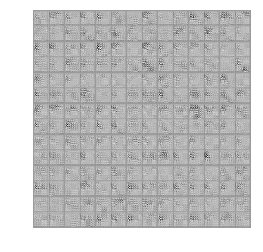

50 0.67810774 0.7312871 0.69973475 0.65648085


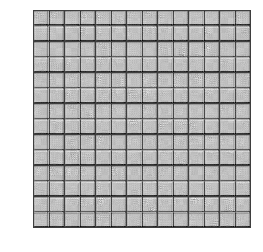

100 0.5512096 1.1268051 0.70708585 0.39533344
not training discriminator


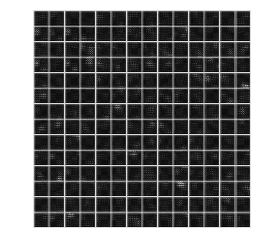

150 0.50000614 1.0083061 0.5279905 0.47202176
not training discriminator


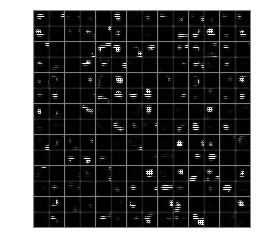

200 0.5078193 1.156125 0.5752475 0.44039103
not training discriminator


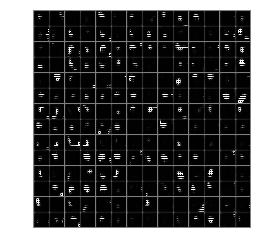

250 0.52780724 1.2908742 0.65938616 0.3962283
not training discriminator


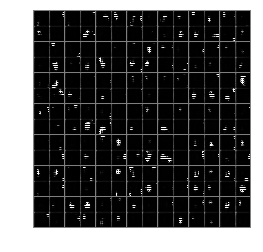

300 0.7298564 1.5369278 1.1546246 0.30508825
not training discriminator


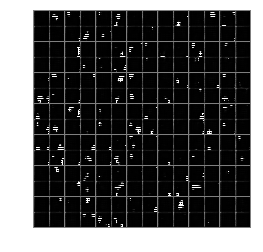

350 0.61028516 0.66895986 0.4123199 0.8082504


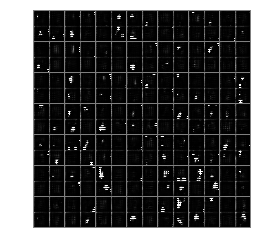

400 0.56839156 0.601286 0.2920999 0.8446833


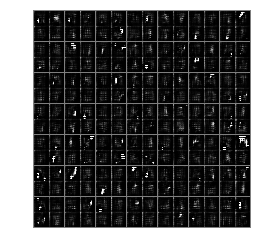

450 0.6152149 0.48838124 0.2418371 0.98859257


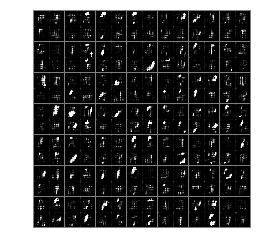

500 0.8061623 1.7600607 1.4093013 0.20302317
not training discriminator


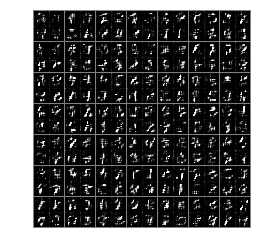

550 0.7210861 1.5565009 1.2009246 0.24124742
not training discriminator


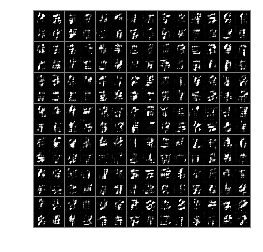

600 0.5604213 1.3246349 0.7873241 0.3335185
not training discriminator


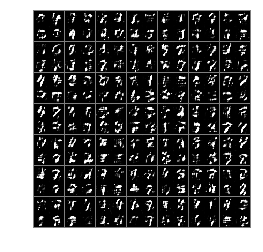

650 0.52294016 0.99984866 0.5457538 0.5001266


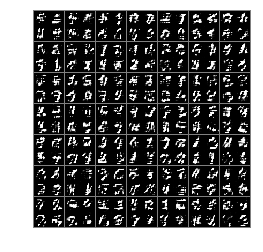

700 0.68473893 1.575764 1.129512 0.23996583
not training discriminator


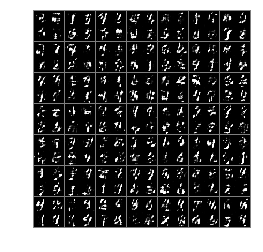

750 0.74295205 1.5893241 1.2456981 0.240206
not training discriminator


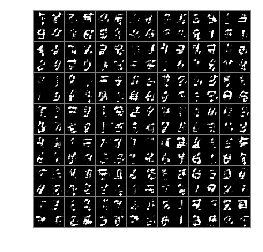

800 0.54298806 1.1832004 0.6909417 0.39503443
not training discriminator


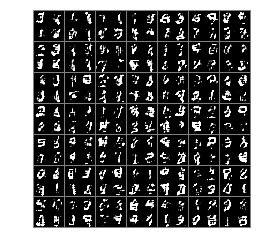

850 0.63629884 1.3495015 0.9478404 0.3247572
not training discriminator


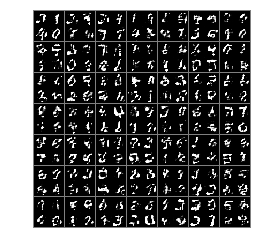

900 0.6454472 1.3497461 0.9738583 0.31703606
not training discriminator


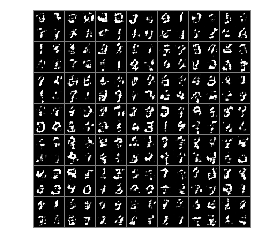

950 0.5895286 1.292198 0.8345963 0.34446093
not training discriminator


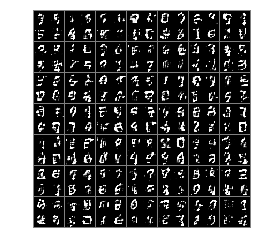

1000 0.58030194 1.2328279 0.7826946 0.37790945
not training discriminator


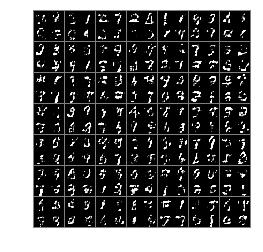

1050 0.6031472 1.3561654 0.8862435 0.32005104
not training discriminator


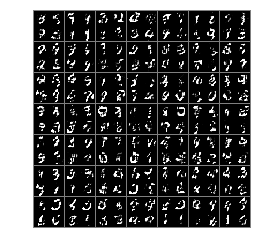

1100 0.6902815 1.4691432 1.1007006 0.2798623
not training discriminator


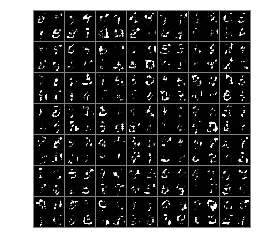

1150 0.61695987 1.4878367 0.9498431 0.2840766
not training discriminator


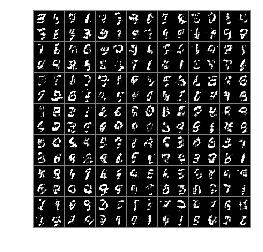

1200 0.5381834 1.1865206 0.6742783 0.40208846
not training discriminator


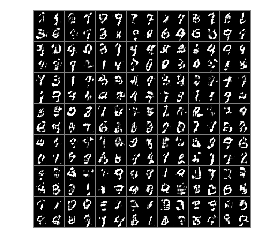

1250 0.60467815 1.3092206 0.86990935 0.33944705
not training discriminator


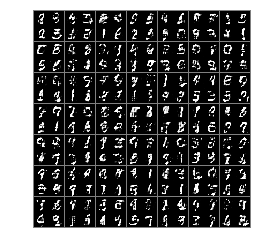

1300 0.5944282 1.2820765 0.82941467 0.35944173
not training discriminator


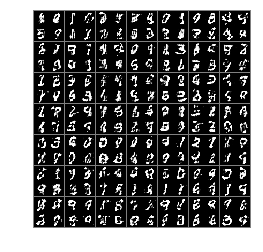

1350 0.61456627 1.316091 0.88653225 0.34260035
not training discriminator


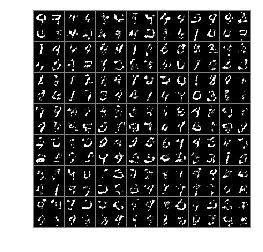

1400 0.71750283 1.5213084 1.1721125 0.26289332
not training discriminator


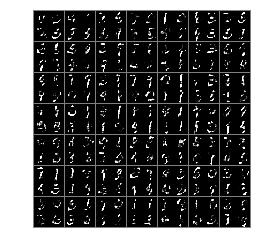

1450 0.69518864 1.6291153 1.1549879 0.23538935
not training discriminator


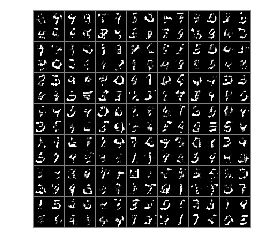

1500 0.5341841 1.2682868 0.6959516 0.37241668
not training discriminator


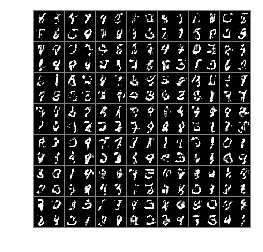

1550 0.57691133 1.1415606 0.6917242 0.46209842


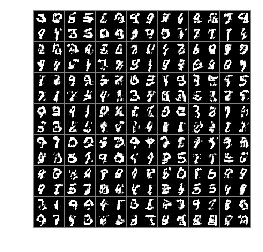

1600 0.5594628 1.16485 0.6948018 0.42412385
not training discriminator


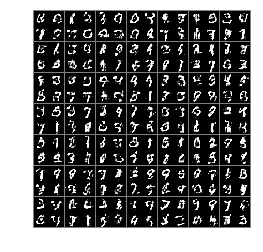

1650 0.6118354 1.2294793 0.83375645 0.38991436
not training discriminator


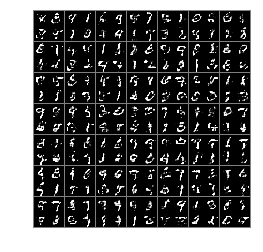

1700 0.6119767 1.2743397 0.8724727 0.3514807
not training discriminator


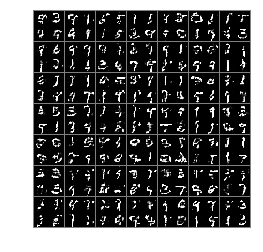

1750 0.61486226 1.4058466 0.9051207 0.32460392
not training discriminator


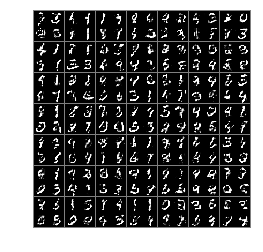

1800 0.57102126 1.1982261 0.74942577 0.39261675
not training discriminator


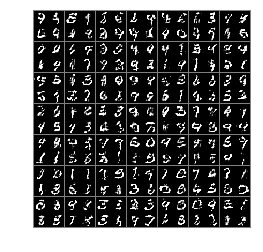

1850 0.5770787 0.6762075 0.3560263 0.7981312


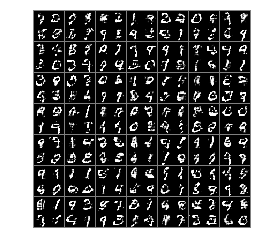

1900 0.57268465 1.1501179 0.7327978 0.41257137
not training discriminator


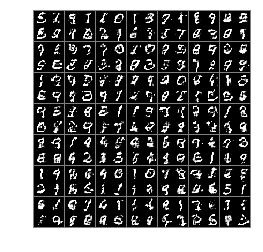

1950 0.5966965 1.2148163 0.81378067 0.37961245
not training discriminator


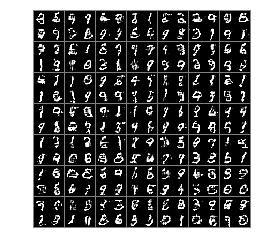

2000 0.5959762 1.3191116 0.8532713 0.33868104
not training discriminator


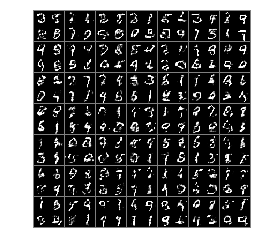

2050 0.6189544 1.2910826 0.8909668 0.3469421
not training discriminator


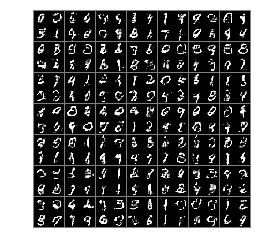

2100 0.5675571 1.1934625 0.7355672 0.39954704
not training discriminator


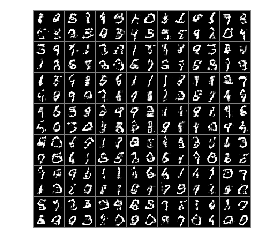

2150 0.5588711 1.2968733 0.76857024 0.34917185
not training discriminator


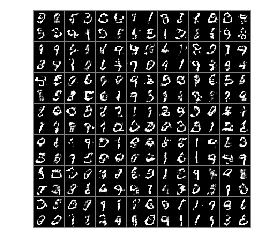

2200 0.6338308 1.2248238 0.89292395 0.37473765


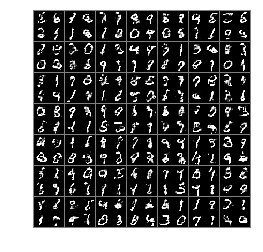

2250 0.5643617 0.7798744 0.45441702 0.6743064


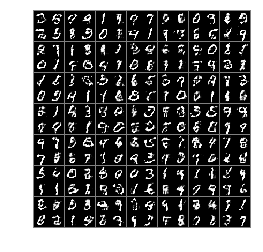

2300 0.58867764 1.237931 0.7933289 0.38402638
not training discriminator


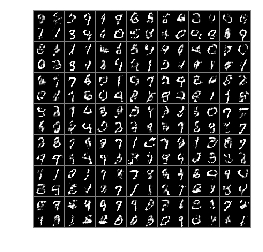

2350 0.55396986 1.2197163 0.7208981 0.38704163
not training discriminator


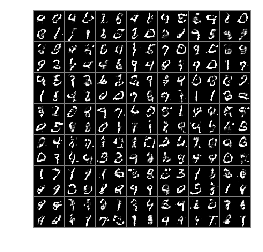

2400 0.63043 1.4638164 0.9717325 0.28912756
not training discriminator


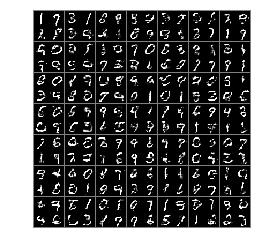

2450 0.63429105 1.3706428 0.9479107 0.32067138
not training discriminator


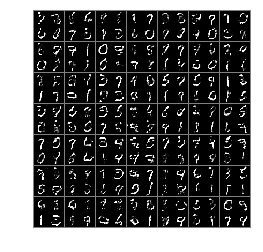

2500 0.5863183 1.3011366 0.80882883 0.36380783
not training discriminator


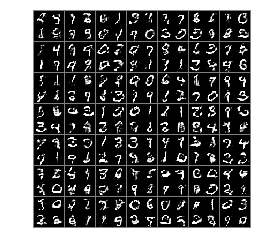

2550 0.6234067 1.3758056 0.92279845 0.3240149
not training discriminator


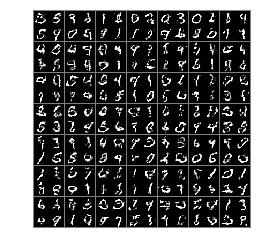

2600 0.5989968 1.1748328 0.79299504 0.4049987


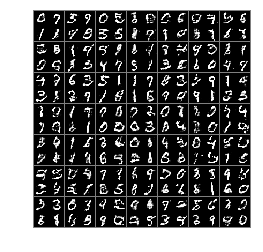

2650 0.6121478 1.2640018 0.86752754 0.356768
not training discriminator


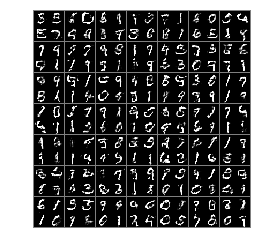

2700 0.5530588 1.1499978 0.70023936 0.4058782
not training discriminator


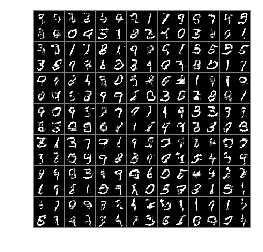

2750 0.5969726 1.3052728 0.8381221 0.35582298
not training discriminator


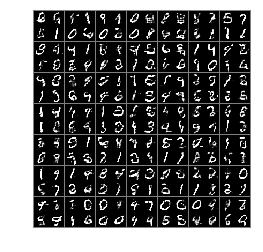

2800 0.61692977 1.2491757 0.86693794 0.36692163
not training discriminator


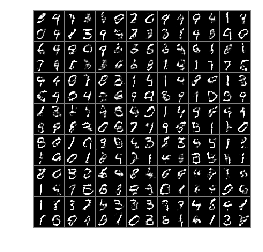

2850 0.56944484 1.1501611 0.7229403 0.41594929
not training discriminator


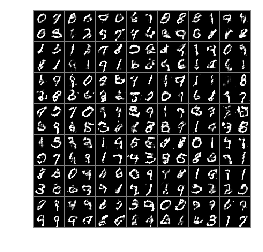

2900 0.58369106 1.118146 0.7397122 0.4276699


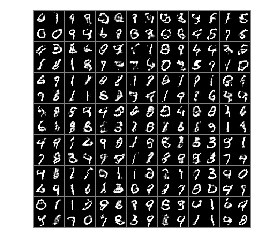

2950 0.57665604 1.3036073 0.8085355 0.34477654
not training discriminator


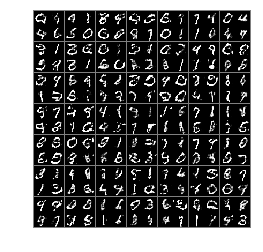

3000 0.5388892 1.2985288 0.7291227 0.3486558
not training discriminator


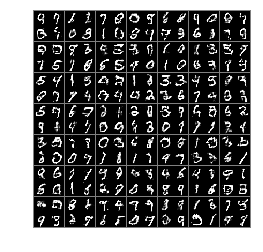

3050 0.575345 1.1910712 0.7450725 0.40561762
not training discriminator


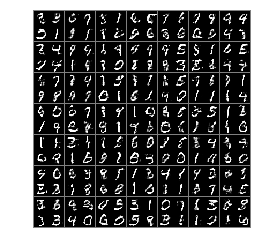

3100 0.58780676 0.6445875 0.34239706 0.8332166


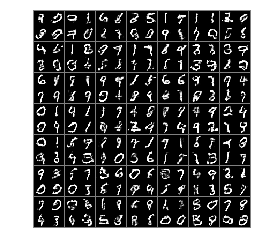

3150 0.5936829 1.3500965 0.8467898 0.34057608
not training discriminator


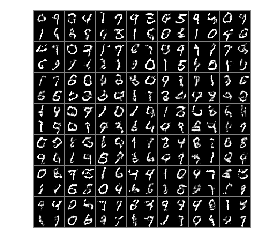

3200 0.6085045 1.2023413 0.8193342 0.3976747


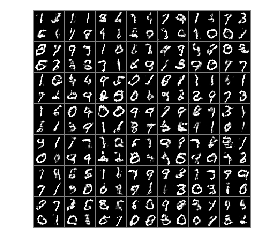

3250 0.587216 1.2151152 0.77334017 0.40109193
not training discriminator


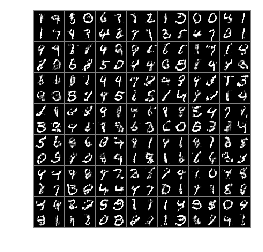

3300 0.6051672 1.282488 0.83805674 0.37227783
not training discriminator


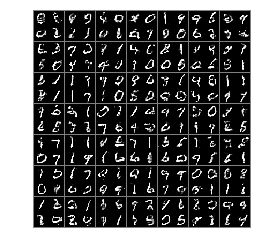

3350 0.5674609 0.71993583 0.3969213 0.73800045


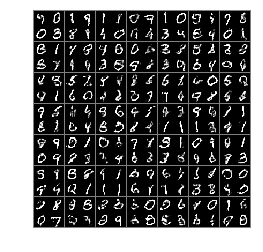

3400 0.62164336 1.2293293 0.8543895 0.38889715


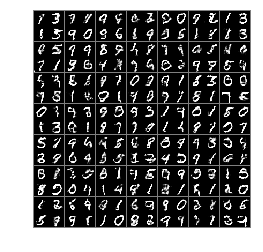

3450 0.5843751 1.3352036 0.82536465 0.34338543
not training discriminator


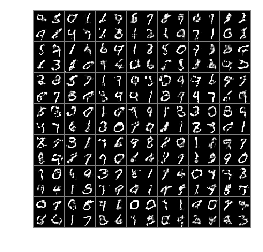

3500 0.5844277 1.220614 0.7833982 0.3854572
not training discriminator


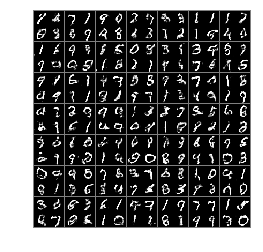

3550 0.5626322 1.1681901 0.715744 0.40952048
not training discriminator


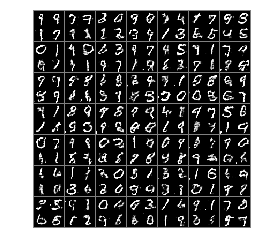

3600 0.61468816 1.3270873 0.877383 0.35199347
not training discriminator


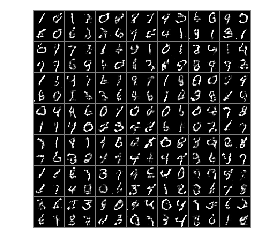

3650 0.60485554 1.2515062 0.8389605 0.37075052
not training discriminator


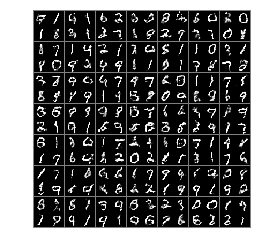

3700 0.5899719 1.2260637 0.7950716 0.38487232
not training discriminator


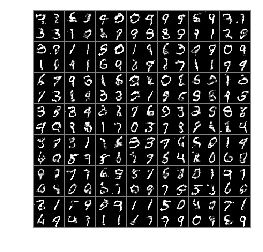

3750 0.57050645 1.2647529 0.7732971 0.36771572
not training discriminator


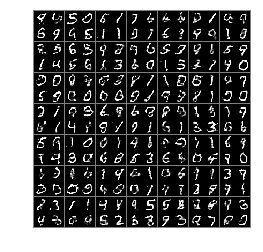

3800 0.6225999 1.2859441 0.8780508 0.3671492
not training discriminator


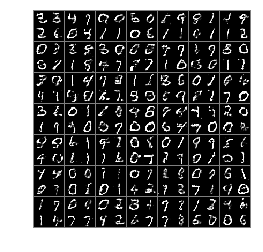

3850 0.56329936 1.2546229 0.750203 0.37639558
not training discriminator


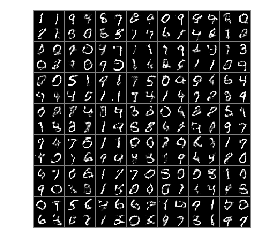

3900 0.55885553 0.8359522 0.47805455 0.6396564


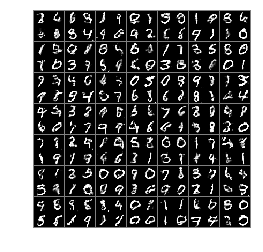

3950 0.6390645 1.3092992 0.9163694 0.36175954
not training discriminator


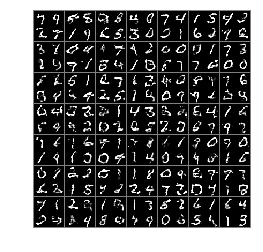

4000 0.60714346 1.2443804 0.8319799 0.38230696
not training discriminator


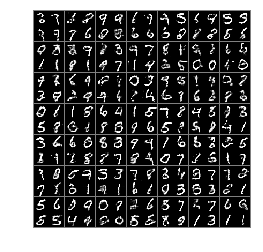

4050 0.62050116 1.3402343 0.90527546 0.33572692
not training discriminator


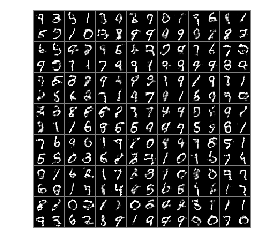

4100 0.5968939 1.3061807 0.81632185 0.37746605
not training discriminator


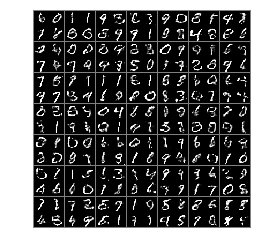

4150 0.5691014 1.2974976 0.78787947 0.35032332
not training discriminator


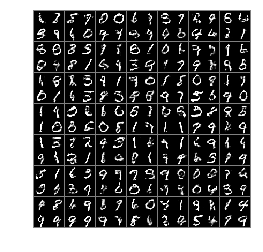

4200 0.6153841 1.2526726 0.84446204 0.38630614
not training discriminator


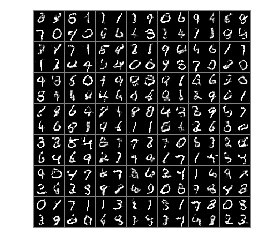

4250 0.5943528 1.2524124 0.8090443 0.37966144
not training discriminator


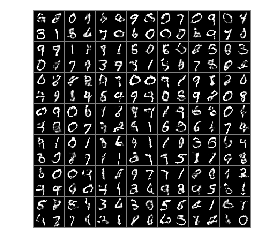

4300 0.5743763 0.6551364 0.31007504 0.8386774


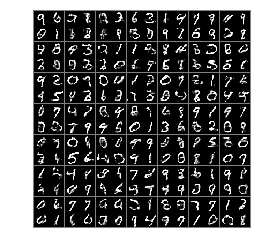

4350 0.5928204 1.2376356 0.79262 0.39302072
not training discriminator


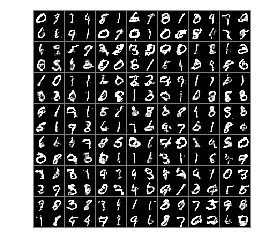

4400 0.6211944 1.5278814 0.97058547 0.2718035
not training discriminator


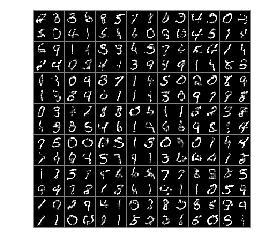

4450 0.6225267 1.2913612 0.87793714 0.36711627
not training discriminator


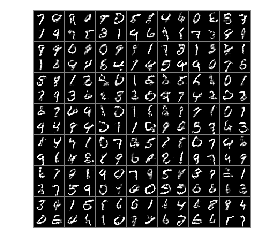

4500 0.5662722 1.1437933 0.7016692 0.43087518
not training discriminator


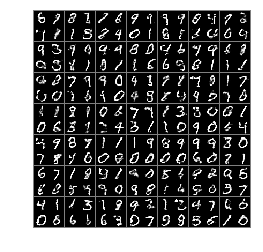

4550 0.57217413 0.6941536 0.3963092 0.74803895


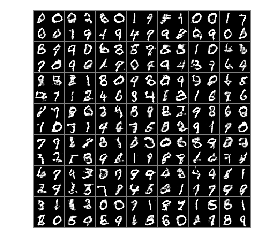

4600 0.5610783 1.2532945 0.7420528 0.38010386
not training discriminator


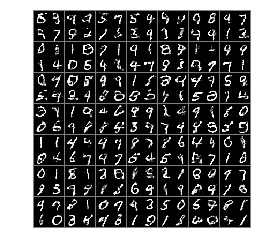

4650 0.5616776 1.1258581 0.69066906 0.4326861
not training discriminator


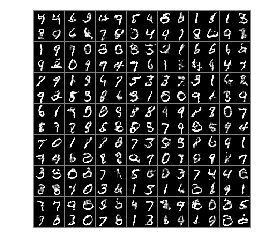

4700 0.586235 1.3185395 0.8129788 0.35949132
not training discriminator


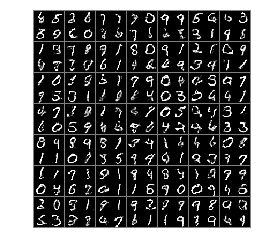

4750 0.64636075 1.2553476 0.9090403 0.38368127


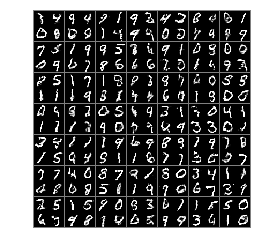

4800 0.58436143 1.3129774 0.8206167 0.3481061
not training discriminator


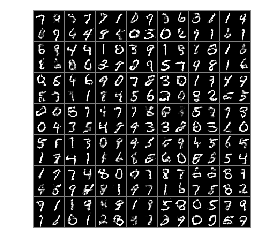

4850 0.56107146 1.2895961 0.7620002 0.36014265
not training discriminator


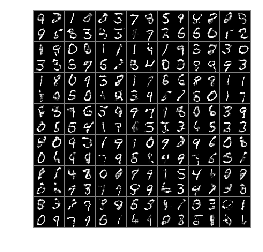

4900 0.58626777 1.2356988 0.785965 0.38657036
not training discriminator


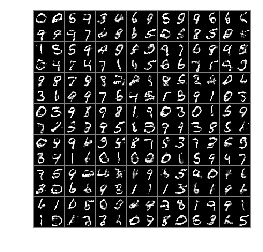

4950 0.5959252 1.3004725 0.8362415 0.35560885
not training discriminator


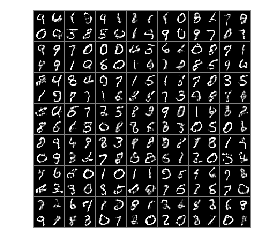

5000 0.584147 1.379354 0.8475624 0.32073155
not training discriminator


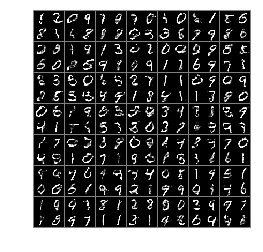

5050 0.5991826 1.2303555 0.8056999 0.39266548
not training discriminator


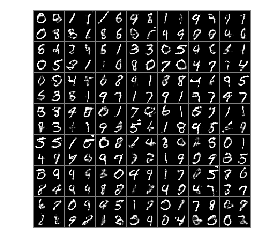

5100 0.59318924 1.3868902 0.8670167 0.31936175
not training discriminator


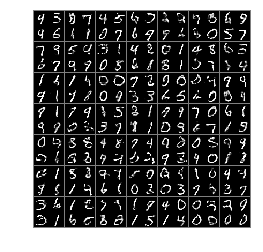

5150 0.5873911 1.3240609 0.83469856 0.3400836
not training discriminator


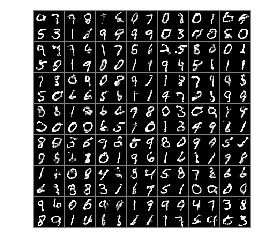

5200 0.58264977 1.2837362 0.8040988 0.36120072
not training discriminator


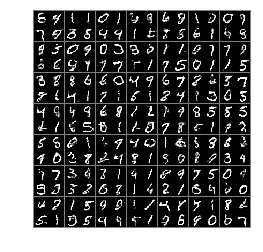

5250 0.633947 0.5362537 0.30212864 0.96576536


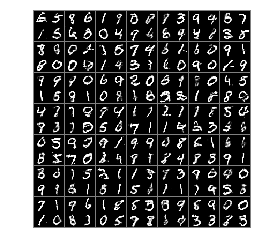

5300 0.62137824 1.4837941 0.95239174 0.29036474
not training discriminator


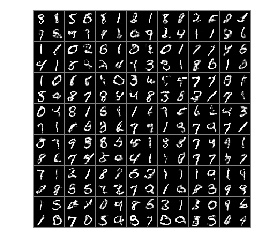

5350 0.62390745 1.263727 0.8480759 0.39973885
not training discriminator


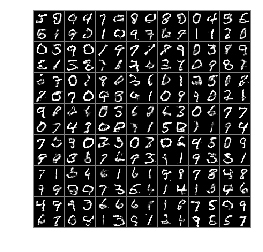

5400 0.64495414 1.3748915 0.9566357 0.33327258
not training discriminator


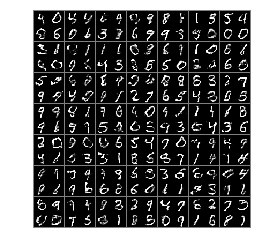

5450 0.5604986 1.1329446 0.6813051 0.43969205
not training discriminator


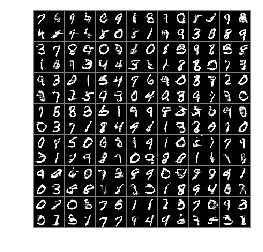

5500 0.6080636 0.6212787 0.3518551 0.86427206


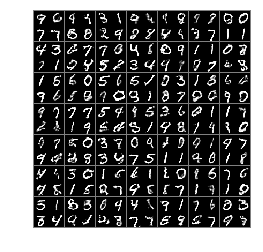

5550 0.65295124 1.3166116 0.9453796 0.36052275
not training discriminator


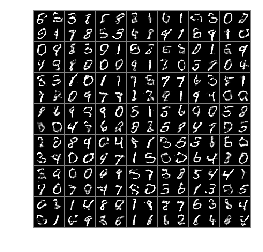

5600 0.6171866 1.2674116 0.8560817 0.37829146
not training discriminator


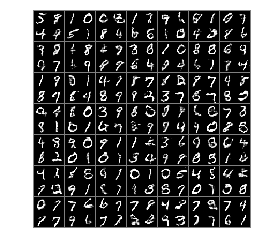

5650 0.61745775 1.2207555 0.8329566 0.401959


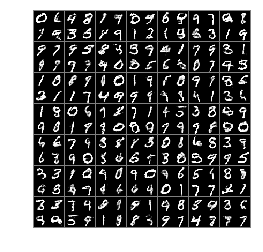

5700 0.5674815 1.3605692 0.8014252 0.33353782
not training discriminator


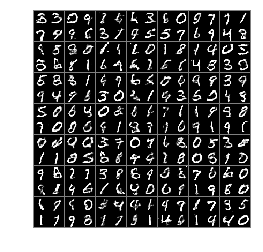

5750 0.61745346 1.197665 0.8192161 0.41569084


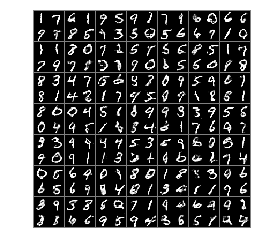

5800 0.5769527 1.2395645 0.76271087 0.39119458
not training discriminator


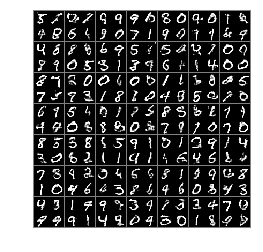

5850 0.58251286 1.160632 0.74084604 0.4241798


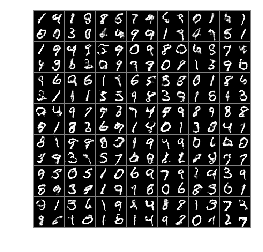

5900 0.60241777 1.243904 0.8197154 0.3851201
not training discriminator


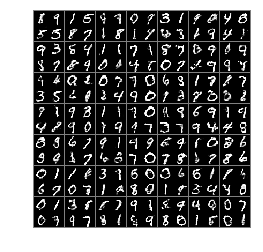

5950 0.53230304 1.2497947 0.6931135 0.3714926
not training discriminator


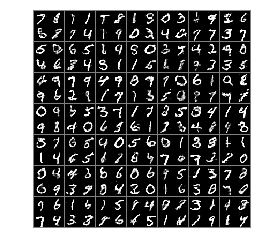

6000 0.574823 0.81700873 0.49276328 0.6568827


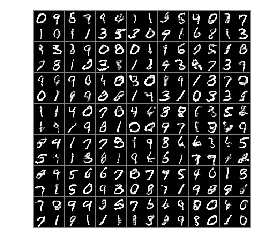

6050 0.6330244 1.3200492 0.9019696 0.36407918
not training discriminator


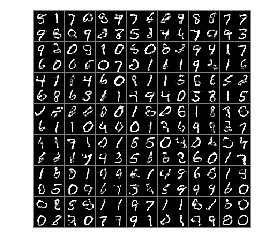

6100 0.6115994 1.4940678 0.9296412 0.2935577
not training discriminator


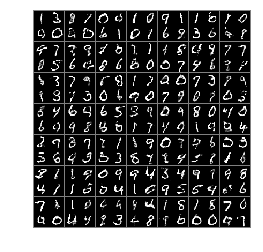

6150 0.5528881 1.1681517 0.6885206 0.4172556
not training discriminator


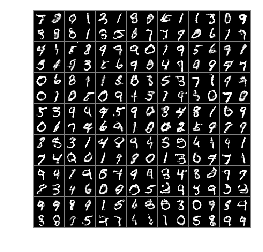

6200 0.6109443 1.2078122 0.82033175 0.40155676


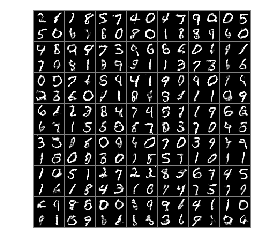

6250 0.65391546 1.4566618 1.0030249 0.30480605
not training discriminator


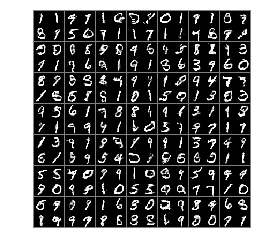

6300 0.61903226 1.4752629 0.9456591 0.29240543
not training discriminator


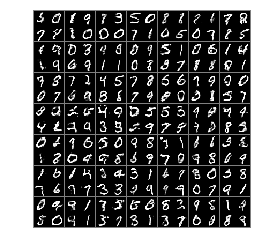

6350 0.5481147 0.83637977 0.4495626 0.6466668


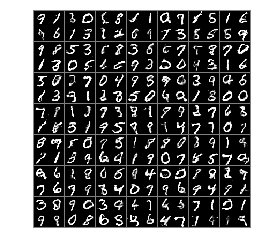

6400 0.57214165 0.7700539 0.4282626 0.7160207


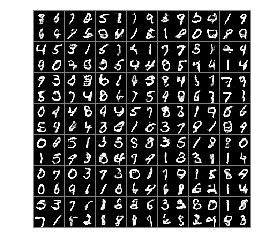

6450 0.5924314 1.3775955 0.8514434 0.3334195
not training discriminator


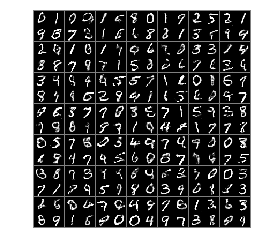

6500 0.6104526 0.57824343 0.30913126 0.91177386


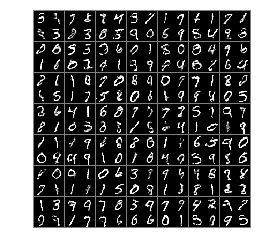

6550 0.5545812 1.3306692 0.7617983 0.34736422
not training discriminator


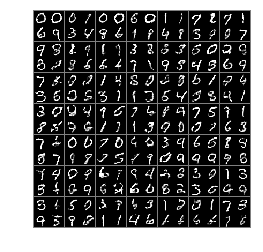

6600 0.5746845 0.7878899 0.4629322 0.6864369


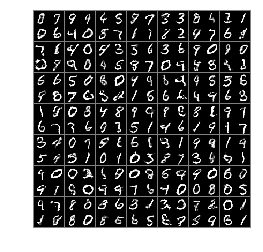

6650 0.624856 1.2890962 0.8856942 0.36401764
not training discriminator


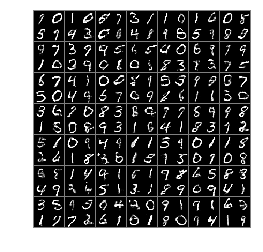

6700 0.5882065 1.3415756 0.82523924 0.35117382
not training discriminator


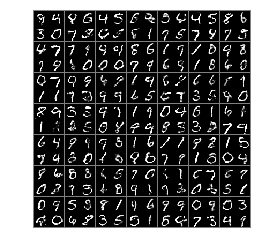

6750 0.53516483 1.1453294 0.63600254 0.4343271
not training discriminator


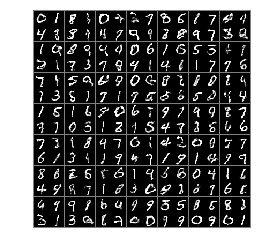

6800 0.58273345 1.1937237 0.7601644 0.40530264
not training discriminator


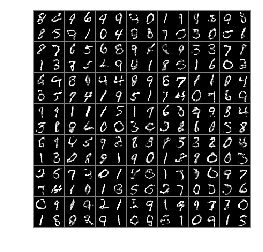

6850 0.582853 1.2645365 0.79605323 0.36965293
not training discriminator


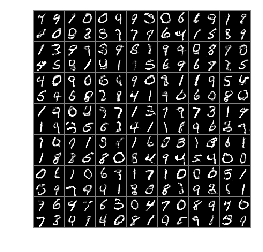

6900 0.61520225 1.1699685 0.8085215 0.4218831


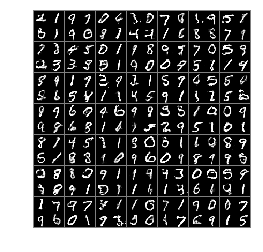

6950 0.6282953 1.4328729 0.9379705 0.31861997
not training discriminator


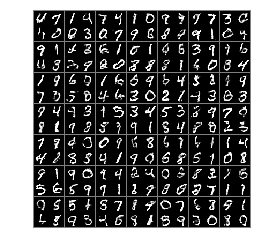

7000 0.60445994 1.3258071 0.85710126 0.3518186
not training discriminator


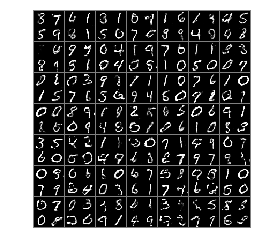

7050 0.57673895 1.3306823 0.81423765 0.3392404
not training discriminator


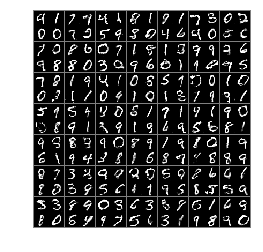

7100 0.576853 1.2615328 0.76249003 0.39121586
not training discriminator


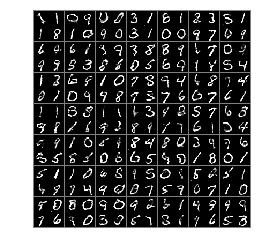

7150 0.57459325 1.2506766 0.7615674 0.38761914
not training discriminator


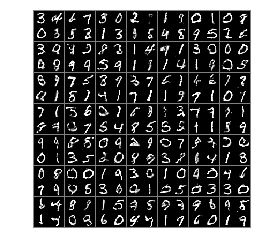

7200 0.61693454 1.3050002 0.87786835 0.3560007
not training discriminator


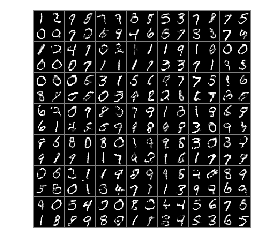

7250 0.56583786 1.3067576 0.7664558 0.36521992
not training discriminator


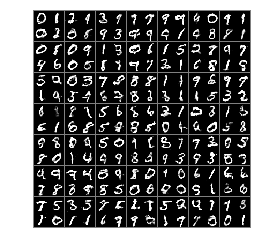

7300 0.63709784 1.3777783 0.92553455 0.34866104
not training discriminator


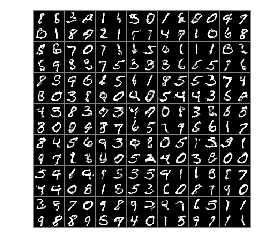

7350 0.5844401 0.7654744 0.4512154 0.71766484


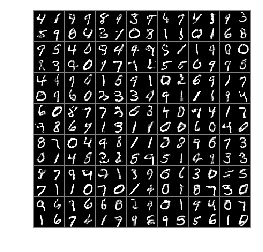

7400 0.5653578 1.346525 0.78547525 0.34524018
not training discriminator


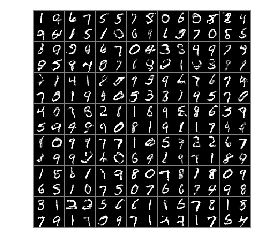

7450 0.6137153 1.2156279 0.8170429 0.41038767


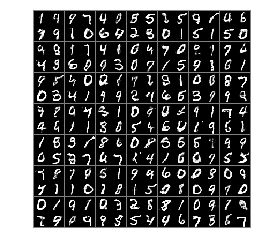

7500 0.5971665 1.1661596 0.7667495 0.4275835


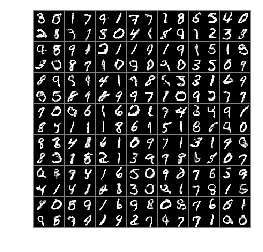

7550 0.5833041 1.2950354 0.80910486 0.35750338
not training discriminator


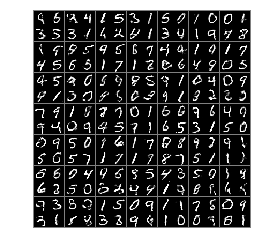

7600 0.5999286 1.3200815 0.83861345 0.3612437
not training discriminator


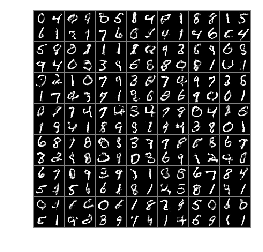

7650 0.58411336 1.36006 0.83084446 0.3373823
not training discriminator


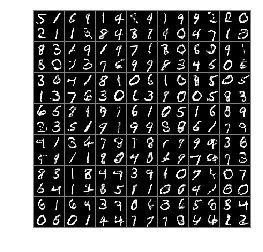

7700 0.6162359 1.2067337 0.8212339 0.41123784


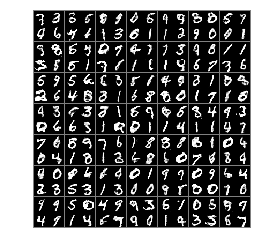

7750 0.55532897 1.17991 0.6944335 0.41622442
not training discriminator


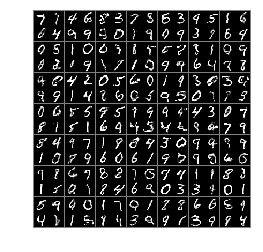

7800 0.65102607 1.3434961 0.9343038 0.36774817
not training discriminator


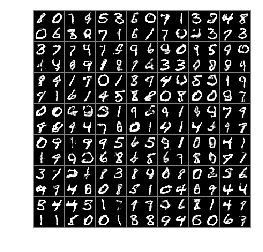

7850 0.60153395 0.6718152 0.3828638 0.82020414


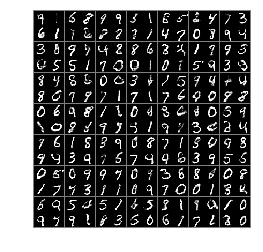

7900 0.6112433 1.2931507 0.8458183 0.37666842
not training discriminator


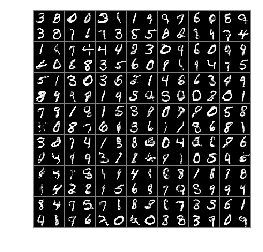

7950 0.619742 1.2494936 0.8598594 0.3796246
not training discriminator


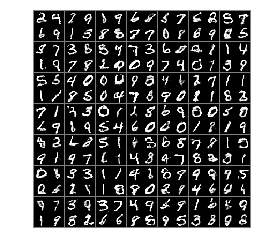

8000 0.5888902 0.7384864 0.43424135 0.743539


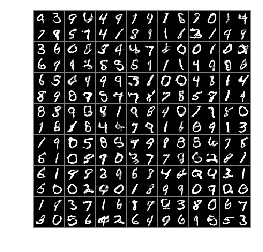

8050 0.5893137 1.2239459 0.7922679 0.3863593
not training discriminator


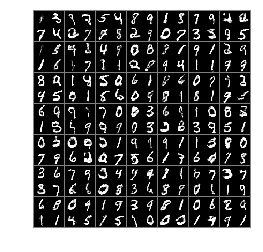

8100 0.6549899 1.3493235 0.9517077 0.35827202
not training discriminator


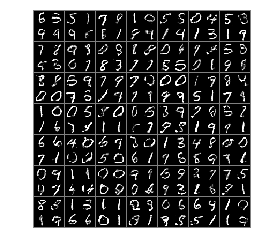

8150 0.5683666 0.817367 0.46726358 0.66946954


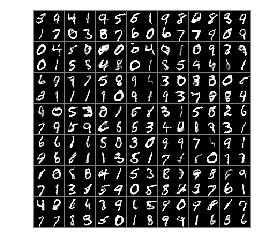

8200 0.55961597 0.7855201 0.44476685 0.6744651


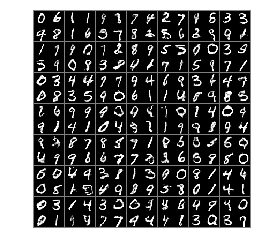

8250 0.6076766 1.2812971 0.8476558 0.36769736
not training discriminator


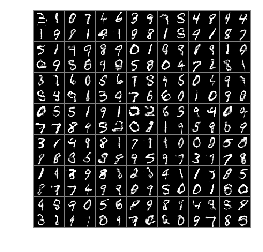

8300 0.60472125 1.3572398 0.87906307 0.3303795
not training discriminator


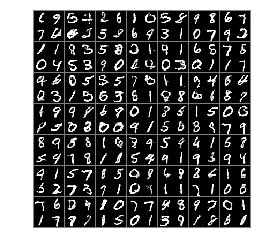

8350 0.6030389 1.2740892 0.821681 0.38439673
not training discriminator


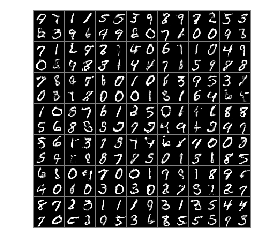

8400 0.6119768 1.3717464 0.8803215 0.34363204
not training discriminator


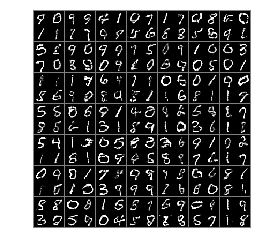

8450 0.5744328 1.2429636 0.7682427 0.38062286
not training discriminator


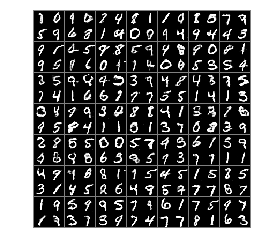

8500 0.6090293 1.2149417 0.7954559 0.42260286


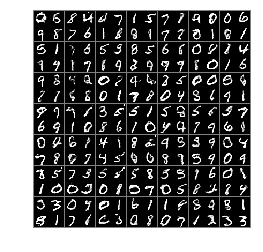

8550 0.58832747 1.1569927 0.74311876 0.43353614


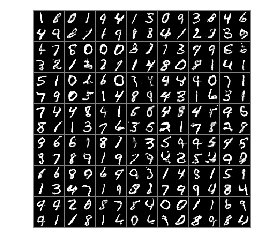

8600 0.57434714 1.2946278 0.78604376 0.36265063
not training discriminator


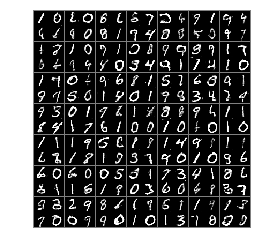

8650 0.5741569 1.2706006 0.785611 0.36270267
not training discriminator


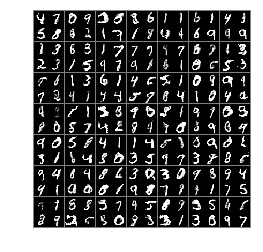

8700 0.5901453 1.3331158 0.83911264 0.34117773
not training discriminator


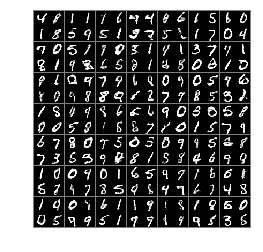

8750 0.6520141 1.2672584 0.93319595 0.37083232


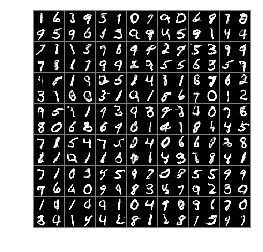

8800 0.5644574 1.1693932 0.6850451 0.44386962
not training discriminator


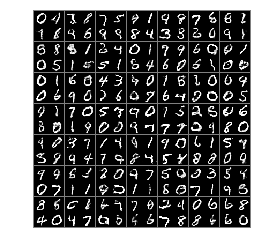

8850 0.5776753 1.2974067 0.78240716 0.37294325
not training discriminator


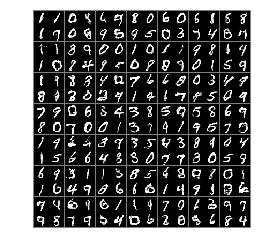

8900 0.58568805 0.83950067 0.5147415 0.65663457


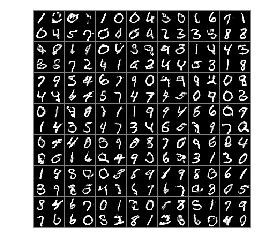

8950 0.53747755 1.1769449 0.6595808 0.41537422
not training discriminator


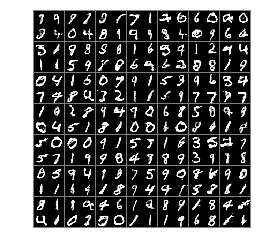

9000 0.65209687 1.321165 0.93935674 0.36483693
not training discriminator


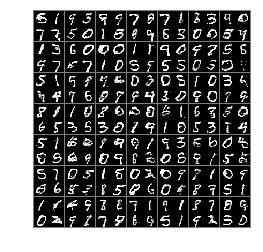

9050 0.56135464 1.2153285 0.7188733 0.40383592
not training discriminator


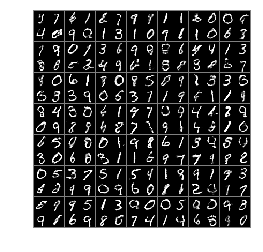

9100 0.56986386 1.2035155 0.6981436 0.44158402
not training discriminator


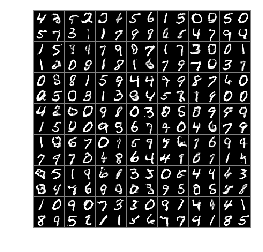

9150 0.59918207 1.4508498 0.8864673 0.31189686
not training discriminator


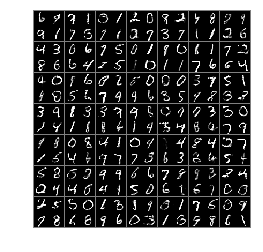

9200 0.60035014 1.5456277 0.9221137 0.27858645
not training discriminator


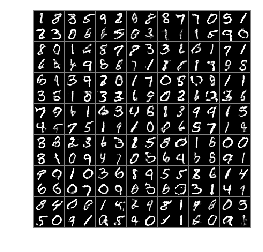

9250 0.5861653 1.3217012 0.7947405 0.37759018
not training discriminator


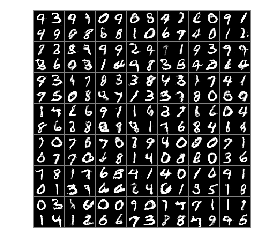

9300 0.6306765 1.3717846 0.9278595 0.33349353
not training discriminator


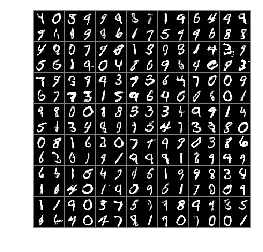

9350 0.6486218 1.2423229 0.8852775 0.41196606


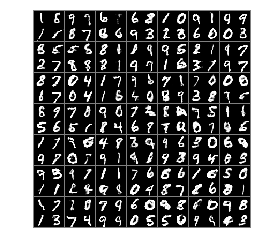

9400 0.5603108 1.2810946 0.751184 0.36943755
not training discriminator


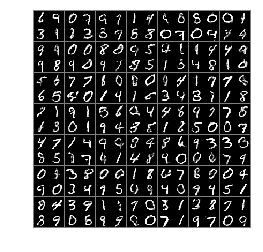

9450 0.58180666 1.2336291 0.7758801 0.3877333
not training discriminator


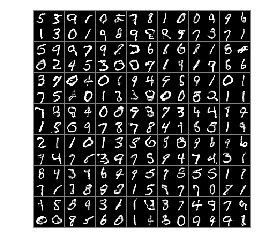

9500 0.5778278 1.2481444 0.76619864 0.38945684
not training discriminator


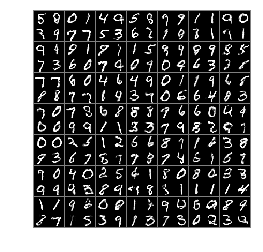

9550 0.5821259 1.4327132 0.847141 0.3171107
not training discriminator


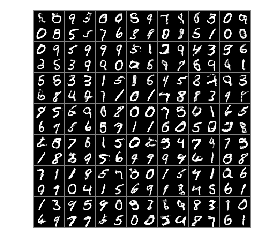

9600 0.64764017 1.3406698 0.92993724 0.36534306
not training discriminator


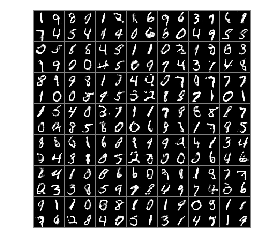

9650 0.57018673 1.156751 0.71976453 0.420609
not training discriminator


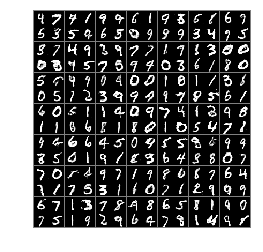

9700 0.6524278 1.3045079 0.94226277 0.36259273


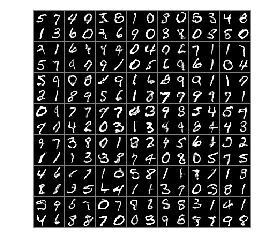

9750 0.535822 1.3344201 0.7264152 0.34522882
not training discriminator


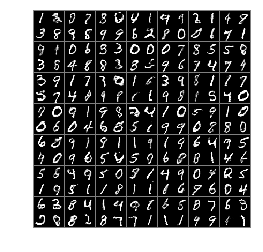

9800 0.5564067 1.1847107 0.69205374 0.4207597
not training discriminator


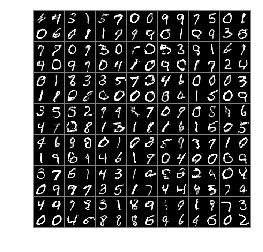

9850 0.5708554 0.75439835 0.4317722 0.7099385


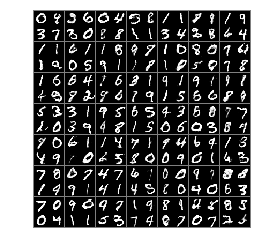

9900 0.6049438 1.1061201 0.75878704 0.45110053


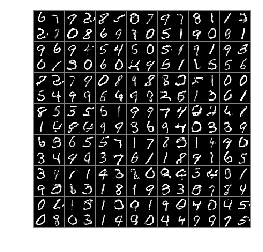

9950 0.58473074 1.2251997 0.77321404 0.39624724
not training discriminator


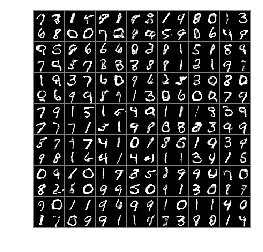

10000 0.57120186 1.1481003 0.7092801 0.43312377
not training discriminator


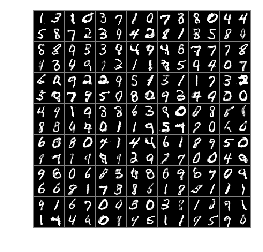

10050 0.5405564 1.0369978 0.5863802 0.49473253


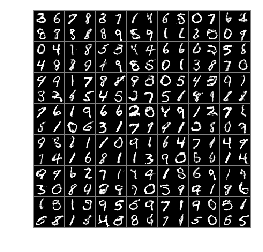

10100 0.5640502 1.1337919 0.668208 0.45989236
not training discriminator


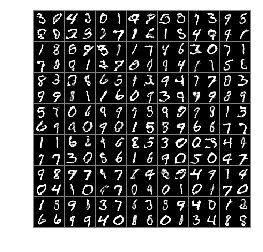

10150 0.5949165 1.158326 0.75550365 0.43432936


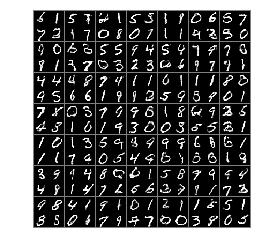

10200 0.56766796 1.1768345 0.72331053 0.41202542
not training discriminator


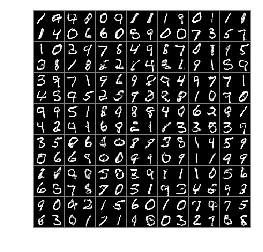

10250 0.56309366 1.1522349 0.6845151 0.4416721
not training discriminator


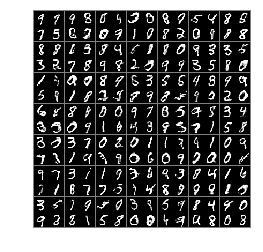

10300 0.5839314 1.3028597 0.80496776 0.36289504
not training discriminator


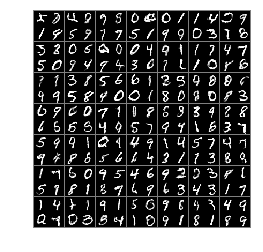

10350 0.5761603 1.1795315 0.71511436 0.4372064
not training discriminator


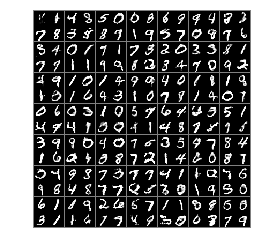

10400 0.5702857 1.2922847 0.78220546 0.3583659
not training discriminator


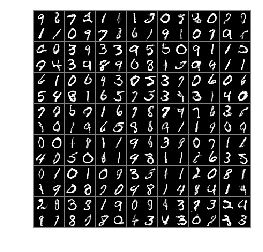

10450 0.5660985 1.2952788 0.77509993 0.35709715
not training discriminator


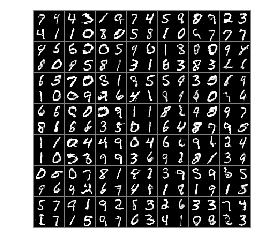

10500 0.5762511 1.5262762 0.87219644 0.28030577
not training discriminator


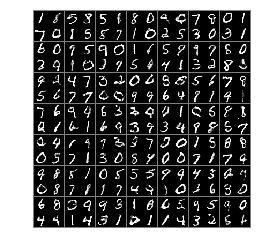

10550 0.5955696 1.2084205 0.7917429 0.3993964
not training discriminator


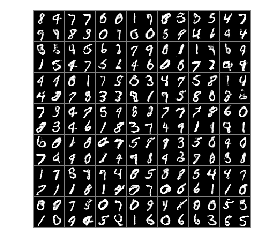

10600 0.63583565 1.285511 0.9076536 0.36401772
not training discriminator


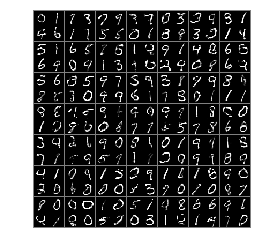

10650 0.6185567 1.3214731 0.8896385 0.34747502
not training discriminator


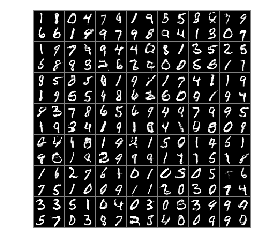

10700 0.6103986 0.6480727 0.37102267 0.8497745


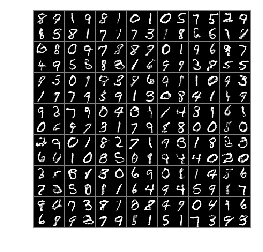

10750 0.62358433 1.2427623 0.8561328 0.39103606


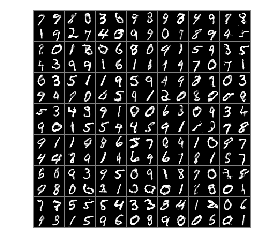

10800 0.6720642 1.4613994 1.0178794 0.3262489
not training discriminator


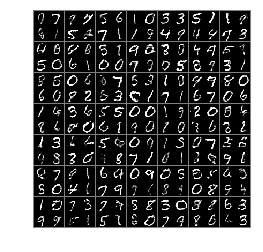

10850 0.59723717 1.1029904 0.7343859 0.46008834


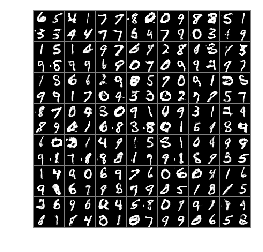

10900 0.5740254 1.223398 0.7590297 0.38902104
not training discriminator


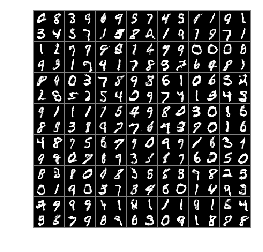

10950 0.54405415 0.789107 0.40746853 0.68063974


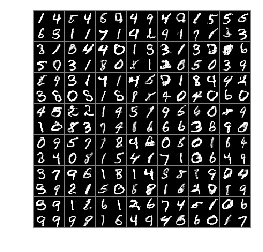

11000 0.59207445 1.2566265 0.8087927 0.37535608
not training discriminator


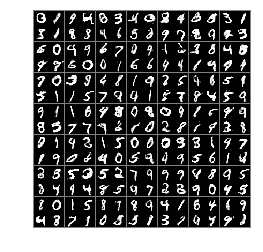

11050 0.63759243 1.3927002 0.94809645 0.32708842
not training discriminator


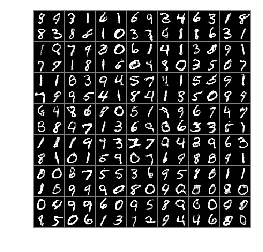

11100 0.65630955 1.3234624 0.9364622 0.37615672
not training discriminator


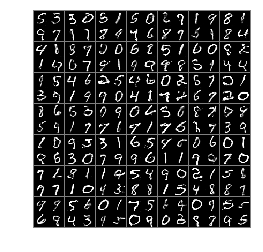

11150 0.6061969 1.3106731 0.8415778 0.370816
not training discriminator


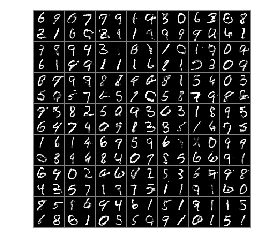

11200 0.5967829 1.2264882 0.7859757 0.40759012
not training discriminator


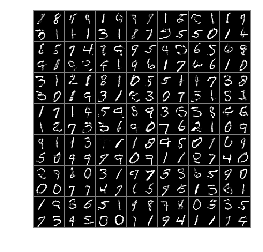

11250 0.5928757 1.3894738 0.85456693 0.3311845
not training discriminator


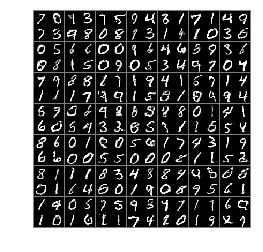

11300 0.6111384 0.5895786 0.29976532 0.9225115


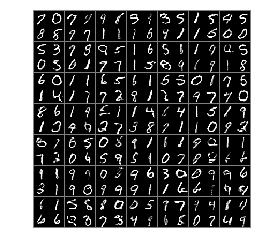

11350 0.5971955 1.4531561 0.8941848 0.30020612
not training discriminator


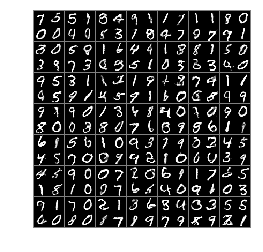

11400 0.6262522 1.2269231 0.8177714 0.4347329


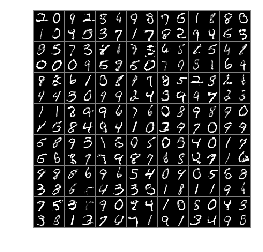

11450 0.59484196 1.3154325 0.83041984 0.35926408
not training discriminator


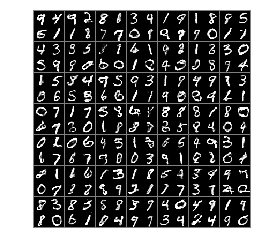

11500 0.54908544 0.84514457 0.46401852 0.6341524


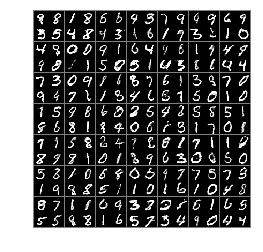

11550 0.54570043 0.77768546 0.40186754 0.6895333


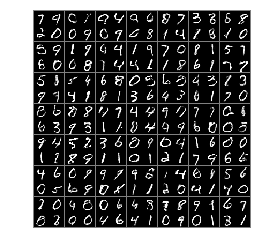

11600 0.54481757 0.83188105 0.45253628 0.6370988


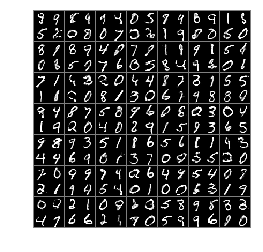

11650 0.6821616 1.5695236 1.0775723 0.28675088
not training discriminator


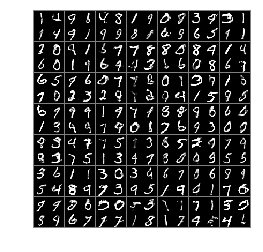

11700 0.58687145 1.2114697 0.7698593 0.40388364
not training discriminator


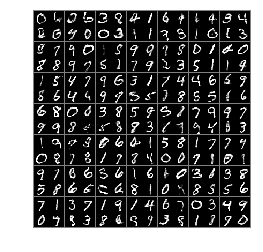

11750 0.56394756 0.7680656 0.42919874 0.6986964


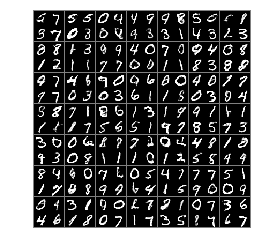

11800 0.58870023 1.4418038 0.8751815 0.3022191
not training discriminator


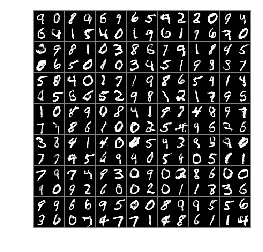

11850 0.64623255 1.4490082 0.9598012 0.33266377
not training discriminator


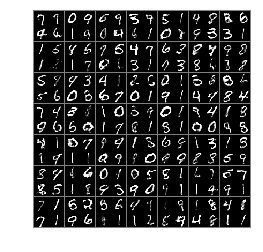

11900 0.6307674 1.4454458 0.95070577 0.31082904
not training discriminator


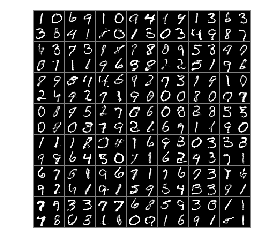

11950 0.5656526 1.0181738 0.6066517 0.52465355


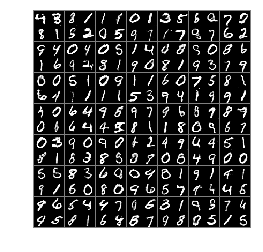

12000 0.6128757 1.295925 0.8559682 0.36978328
not training discriminator


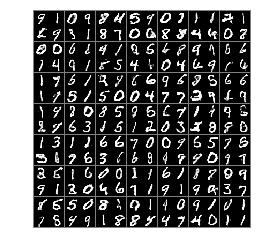

12050 0.5340113 0.8082619 0.3823966 0.685626


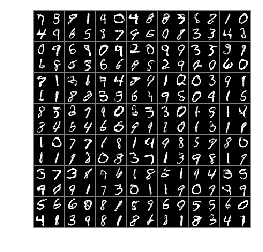

12100 0.58056796 1.2124261 0.74180025 0.41933557
not training discriminator


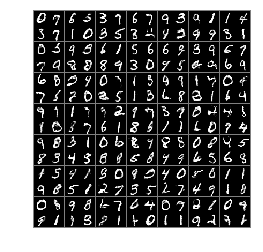

12150 0.5446858 1.1290374 0.6371424 0.45222908
not training discriminator


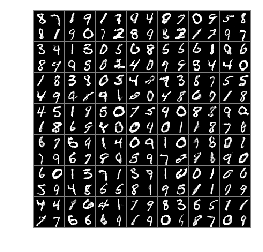

12200 0.58769405 1.1675116 0.7326162 0.4427719


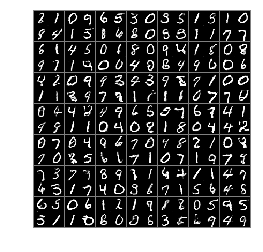

12250 0.63758713 1.4031224 0.9317179 0.3434565
not training discriminator


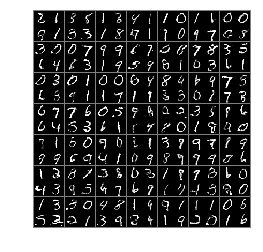

12300 0.60070693 1.3227053 0.83788115 0.36353263
not training discriminator


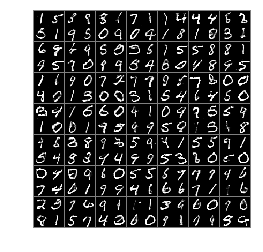

12350 0.5511839 1.2545401 0.7214569 0.38091075
not training discriminator


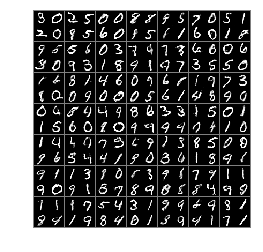

12400 0.640739 1.1259642 0.84063876 0.44083926


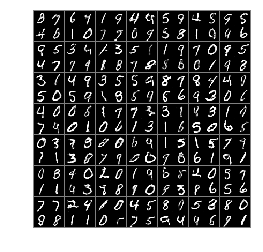

12450 0.5941213 1.3213682 0.8367483 0.35149425
not training discriminator


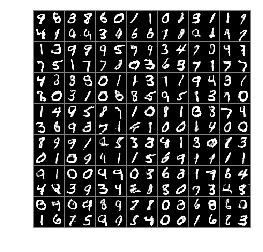

12500 0.5670964 1.2926716 0.7273891 0.40680367
not training discriminator


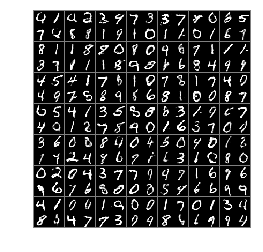

12550 0.5514143 0.74804103 0.37386665 0.728962


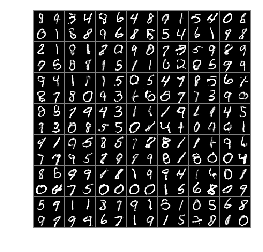

12600 0.62377495 1.4807056 0.9507364 0.29681352
not training discriminator


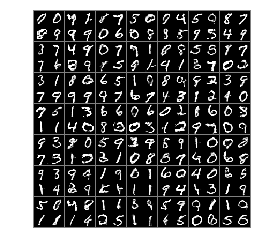

12650 0.5738835 1.3312621 0.78543824 0.3623286
not training discriminator


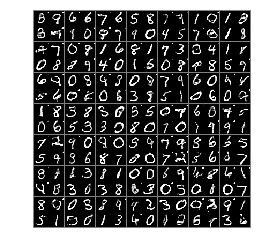

12700 0.6115527 1.2231603 0.825179 0.3979266
not training discriminator


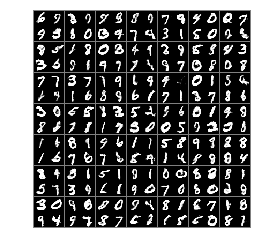

12750 0.5872358 1.3275257 0.80189484 0.3725768
not training discriminator


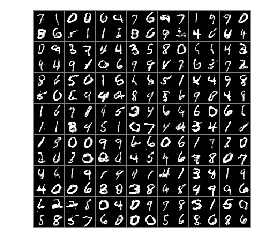

12800 0.6084203 1.2413206 0.8258361 0.3910046
not training discriminator


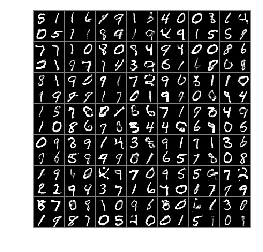

12850 0.58115846 1.2080052 0.7671682 0.3951486
not training discriminator


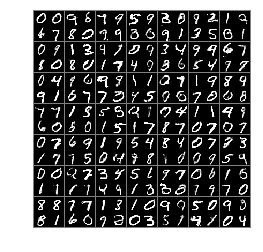

12900 0.56746656 1.0903774 0.65750384 0.47742933


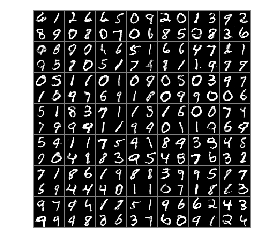

12950 0.55210525 1.2716333 0.7120204 0.39219004
not training discriminator


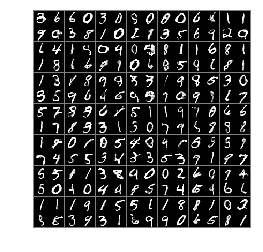

13000 0.5637011 1.2786137 0.7491956 0.37820667
not training discriminator


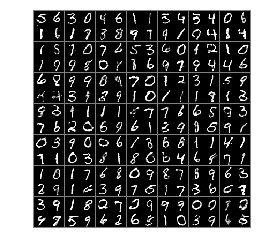

13050 0.6136306 1.3037016 0.8577225 0.3695386
not training discriminator


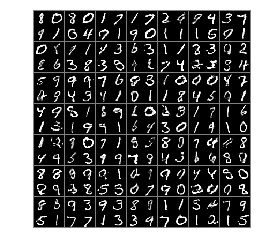

13100 0.6166691 1.1963761 0.8232204 0.4101178


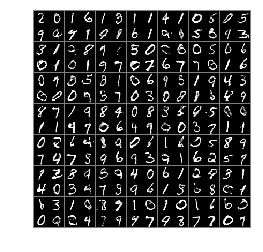

13150 0.6215483 1.2656808 0.8410159 0.4020805
not training discriminator


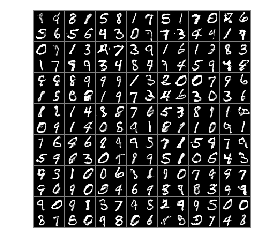

13200 0.52510214 1.2562766 0.6459023 0.40430194
not training discriminator


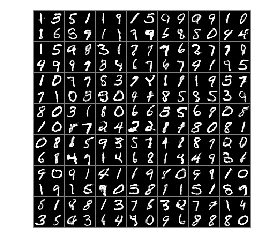

13250 0.610387 1.1923711 0.80062526 0.42014888


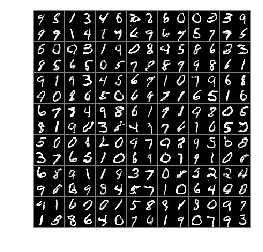

13300 0.578587 1.3101907 0.77663404 0.38053983
not training discriminator


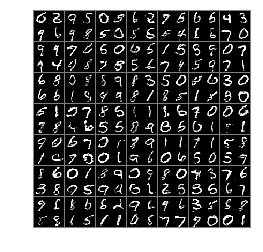

13350 0.6253112 1.1693099 0.82848173 0.42214072


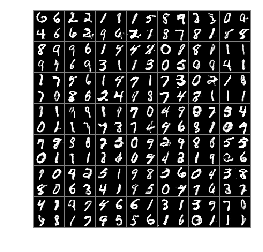

13400 0.6300303 1.2805791 0.8869151 0.37314543
not training discriminator


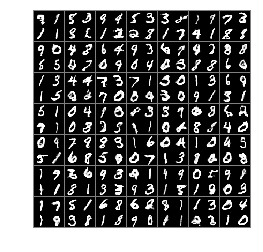

13450 0.62494594 1.4103688 0.9247161 0.32517567
not training discriminator


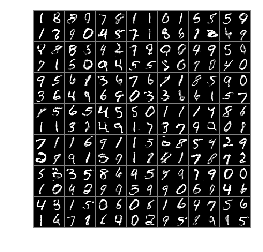

13500 0.6100139 1.2267748 0.8156639 0.404364
not training discriminator


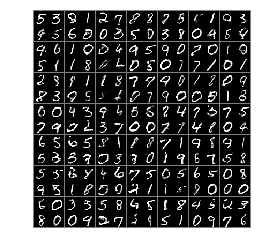

13550 0.53594875 1.0243758 0.5695333 0.50236416


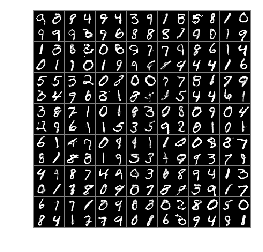

13600 0.5731957 1.0093766 0.6388301 0.5075612


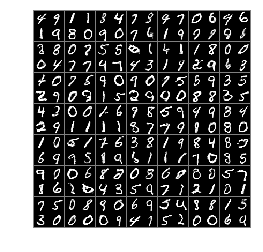

13650 0.555296 1.26941 0.73783237 0.37275976
not training discriminator


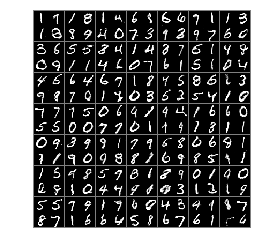

13700 0.5663912 1.3724233 0.79039204 0.34239036
not training discriminator


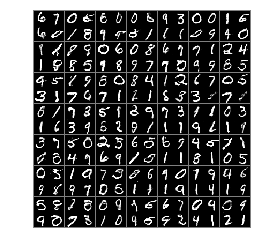

13750 0.54920226 1.259452 0.71104664 0.38735792
not training discriminator


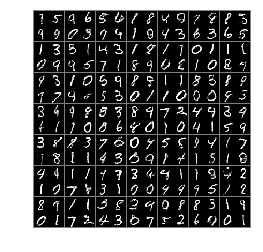

13800 0.5874376 1.2513024 0.7845057 0.39036962
not training discriminator


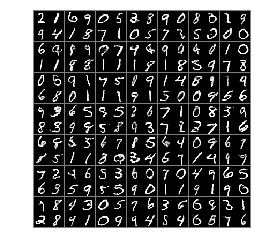

13850 0.54341865 0.85127586 0.45092377 0.6359134


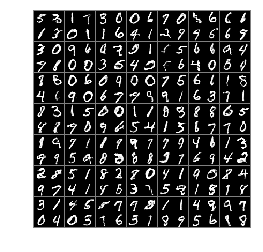

13900 0.5846537 1.2923058 0.78617096 0.38313636
not training discriminator


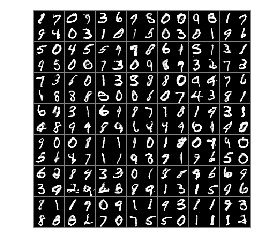

13950 0.5628514 1.2003522 0.71691316 0.40878972
not training discriminator


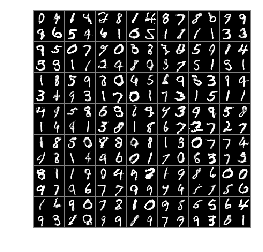

14000 0.58543426 1.2675928 0.7869746 0.38389385
not training discriminator


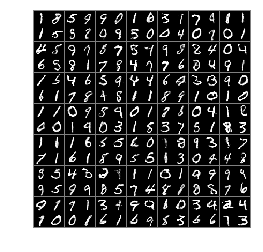

14050 0.5965696 1.4459345 0.8849266 0.30821255
not training discriminator


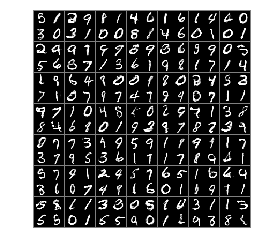

14100 0.6106563 1.5057578 0.9216556 0.2996569
not training discriminator


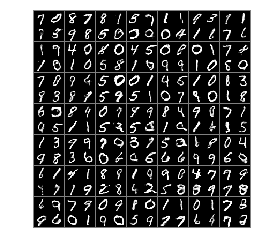

14150 0.5746488 1.3576218 0.8022399 0.34705776
not training discriminator


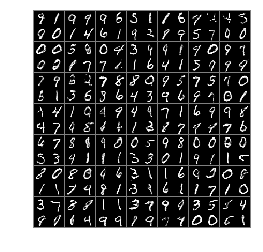

14200 0.6445158 1.3601136 0.92151034 0.3675213
not training discriminator


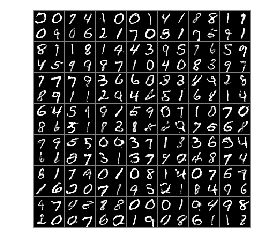

14250 0.5757756 1.2560945 0.74920714 0.40234405
not training discriminator


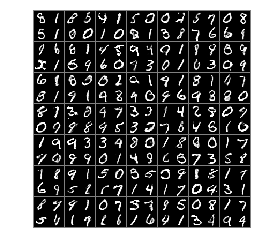

14300 0.59941787 1.2883226 0.7954429 0.40339282
not training discriminator


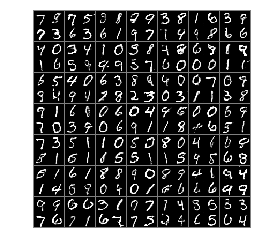

14350 0.6132976 1.3974783 0.8867619 0.33983317
not training discriminator


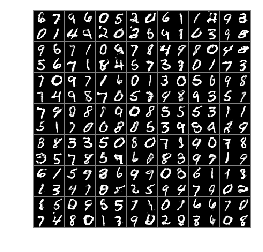

14400 0.5760784 1.1730266 0.7258276 0.42632926
not training discriminator


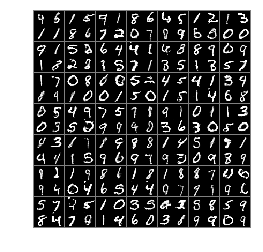

14450 0.543209 1.1079906 0.6181508 0.46826708
not training discriminator


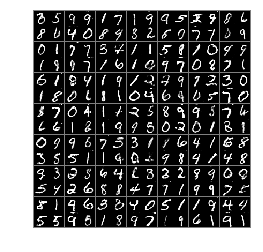

14500 0.60088784 1.430743 0.8943613 0.30741435
not training discriminator


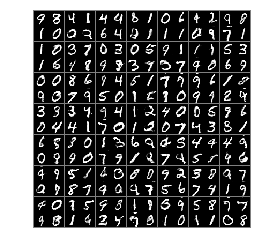

14550 0.5581956 1.0130024 0.5709394 0.5454518


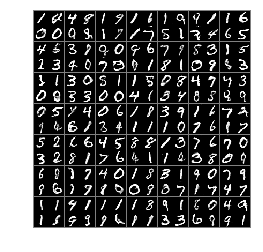

14600 0.56964993 0.76462173 0.42654645 0.7127535


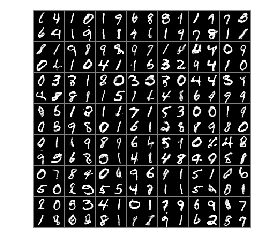

14650 0.57831347 1.2803881 0.797167 0.35945985
not training discriminator


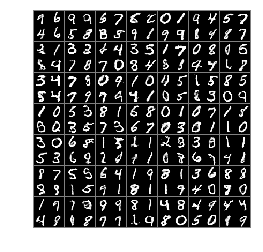

14700 0.5571347 1.0987189 0.64646417 0.46780524


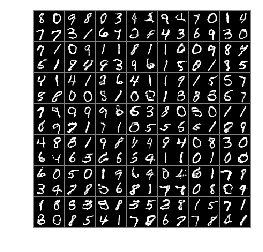

14750 0.58274937 0.756973 0.44553795 0.7199608


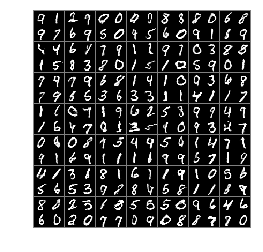

14800 0.55550426 1.1929259 0.71303046 0.3979781
not training discriminator


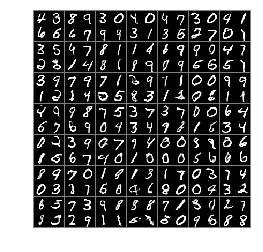

14850 0.56776637 0.73382056 0.38058603 0.7549467


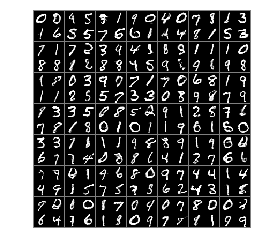

14900 0.5761137 1.3581012 0.80710095 0.34512645
not training discriminator


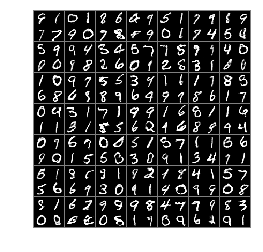

14950 0.59044945 1.2900293 0.7869342 0.39396474
not training discriminator


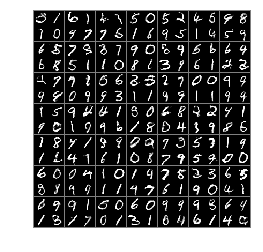

15000 0.5962129 0.670844 0.38350597 0.8089198


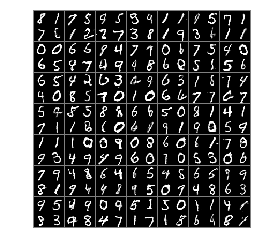

15050 0.54458755 1.3512359 0.7493543 0.33982074
not training discriminator


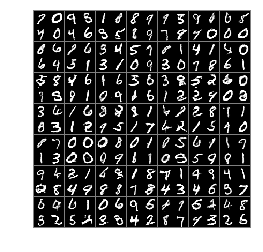

15100 0.6101211 1.3006889 0.8429413 0.3773008
not training discriminator


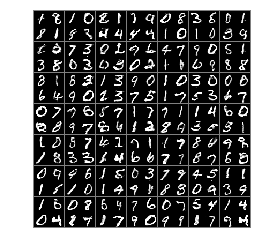

15150 0.53881454 1.0986503 0.6199872 0.45764196
not training discriminator


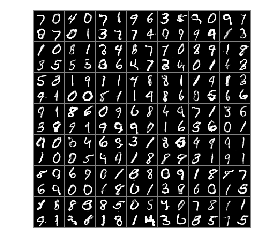

15200 0.582554 1.3291816 0.817778 0.34732997
not training discriminator


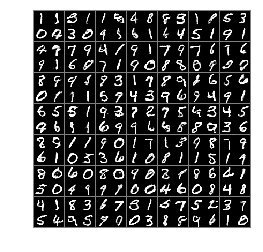

15250 0.5541761 1.2429433 0.7264666 0.38188556
not training discriminator


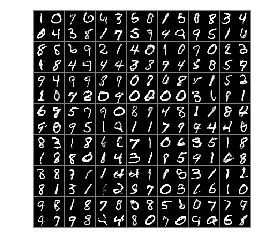

15300 0.6175017 1.2936285 0.876344 0.35865927
not training discriminator


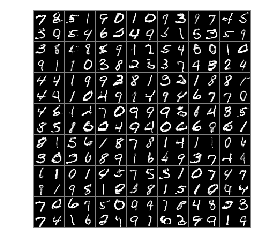

15350 0.5468766 1.1492118 0.64711624 0.44663695
not training discriminator


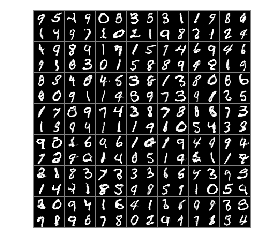

15400 0.6072063 1.3709935 0.8571067 0.35730594
not training discriminator


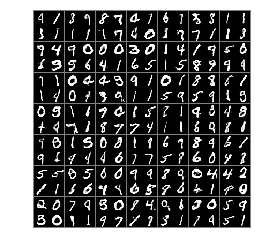

15450 0.59890765 1.2849762 0.8242276 0.3735877
not training discriminator


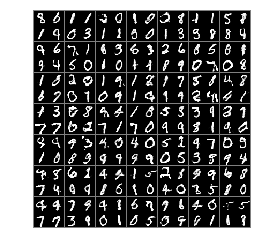

15500 0.58260506 1.3967264 0.8400134 0.3251968
not training discriminator


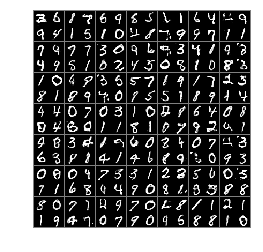

15550 0.6207582 1.3140742 0.89195484 0.34956157
not training discriminator


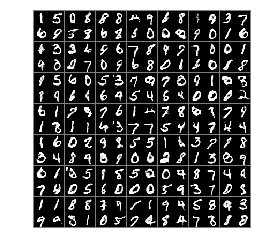

15600 0.6351861 1.5708085 0.98842824 0.2819438
not training discriminator


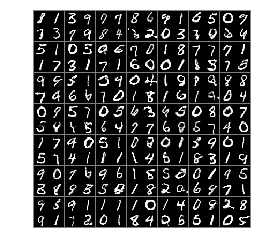

15650 0.57130754 1.3295736 0.7895805 0.3530345
not training discriminator


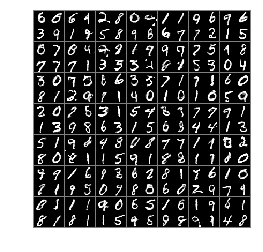

15700 0.6257616 1.4096284 0.91538596 0.33613726
not training discriminator


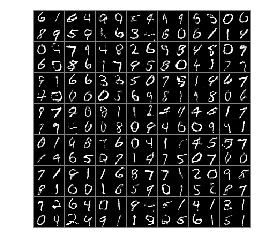

15750 0.606109 1.2939063 0.8495292 0.36268866
not training discriminator


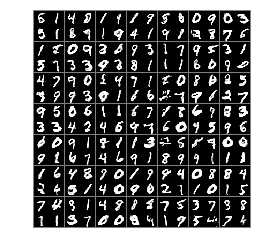

15800 0.6248256 1.1557087 0.7927254 0.45692575


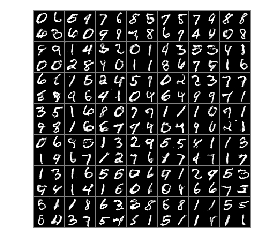

15850 0.59492576 1.402259 0.8589643 0.3308871
not training discriminator


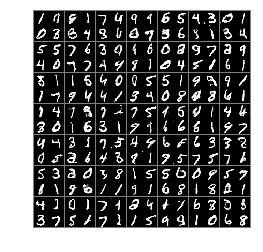

15900 0.61882323 1.2394421 0.83656234 0.40108404
not training discriminator


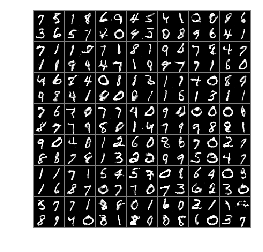

15950 0.56592536 1.2309473 0.7354566 0.39639413
not training discriminator


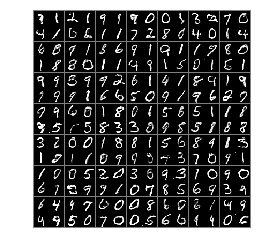

16000 0.5992797 1.2542255 0.8053746 0.39318487
not training discriminator


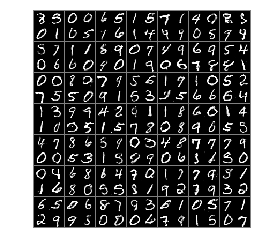

16050 0.6197523 1.2640647 0.85617477 0.38332975
not training discriminator


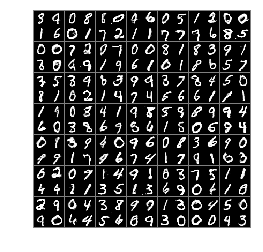

16100 0.5694266 1.1497809 0.70180327 0.43704998
not training discriminator


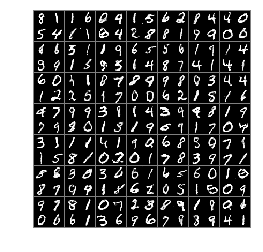

16150 0.58595586 1.3227183 0.8255903 0.34632146
not training discriminator


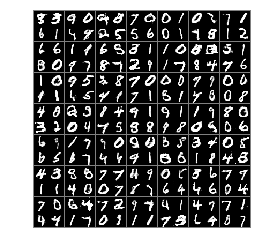

16200 0.60402685 1.1515981 0.7834499 0.4246037


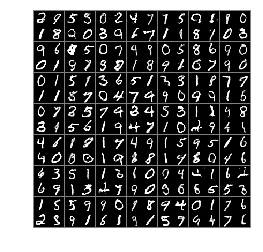

16250 0.6041426 1.1636568 0.75102454 0.45726067


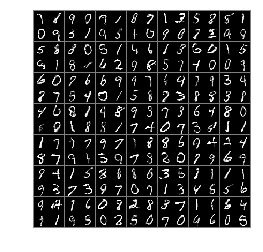

16300 0.59424764 1.2786577 0.8011887 0.38730663
not training discriminator


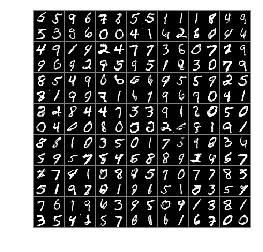

16350 0.57847214 1.185963 0.7345235 0.4224209
not training discriminator


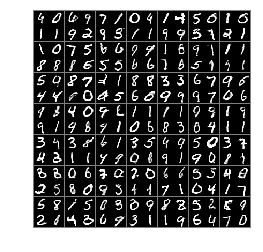

16400 0.61170304 1.2147143 0.83293694 0.39046907


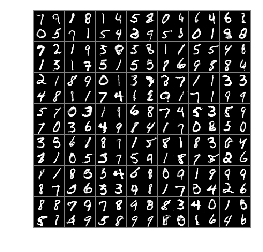

16450 0.54077363 1.1220362 0.6142251 0.46732214
not training discriminator


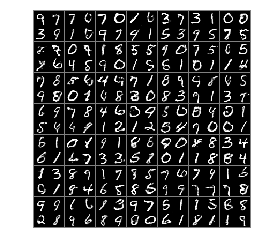

16500 0.5407582 1.2430247 0.69613105 0.38538548
not training discriminator


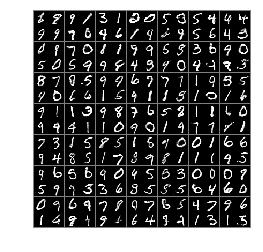

16550 0.55004036 1.2178445 0.681031 0.41904992
not training discriminator


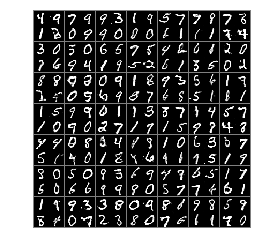

16600 0.55799127 1.2465943 0.73391336 0.38206917
not training discriminator


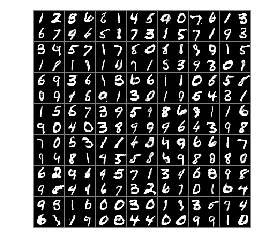

16650 0.5500967 1.1905023 0.68943894 0.41075426
not training discriminator


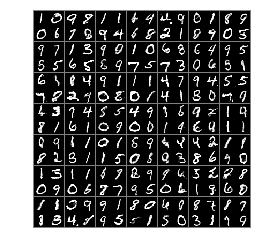

16700 0.61710036 1.4623424 0.9111639 0.32303673
not training discriminator


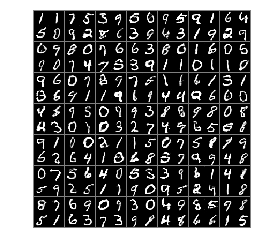

16750 0.6193751 1.2762866 0.8389268 0.3998234
not training discriminator


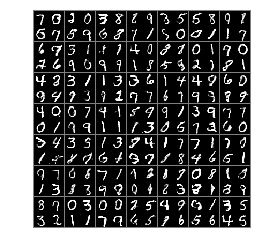

16800 0.5972724 1.2423205 0.8022666 0.39227808
not training discriminator


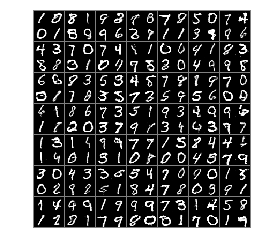

16850 0.7224755 1.4307066 1.0930008 0.35195044


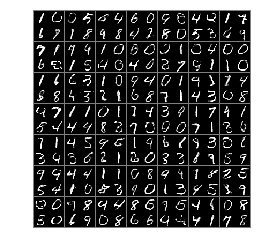

16900 0.6074682 1.557629 0.94356644 0.27136993
not training discriminator


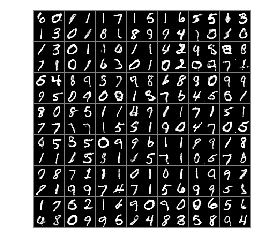

16950 0.6652333 1.597871 1.0623078 0.26815873
not training discriminator


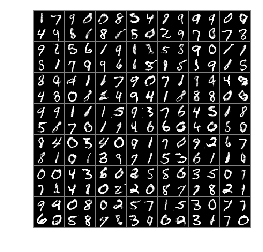

17000 0.55790514 1.2031337 0.6955898 0.42022067
not training discriminator


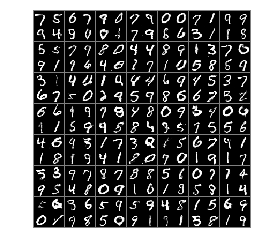

17050 0.58837336 1.2692394 0.7980089 0.37873787
not training discriminator


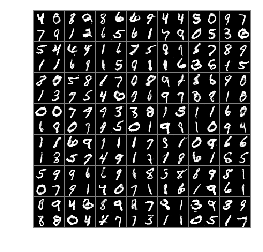

17100 0.5801794 1.2935972 0.8002615 0.36009726
not training discriminator


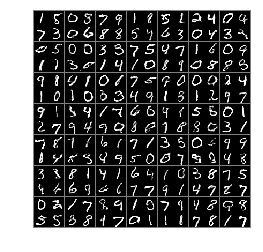

17150 0.5904275 1.2192533 0.7775755 0.4032795
not training discriminator


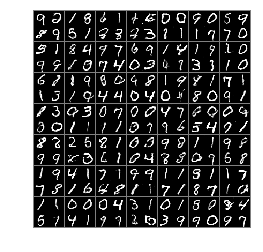

17200 0.5759396 1.2454814 0.76226825 0.389611
not training discriminator


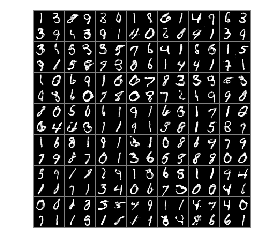

17250 0.54981416 0.8357948 0.43572247 0.66390586


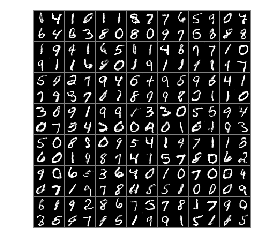

17300 0.59652025 1.1846654 0.7851913 0.40784925


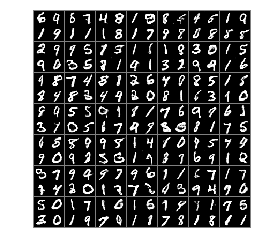

17350 0.63255304 1.272686 0.86412966 0.4009763
not training discriminator


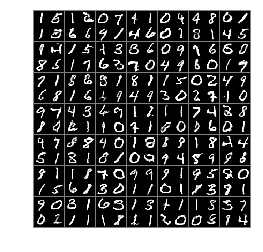

17400 0.6293881 1.3479517 0.9110283 0.3477478
not training discriminator


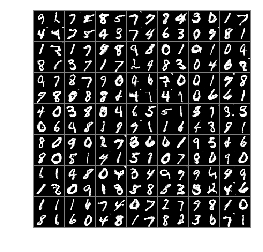

17450 0.5600374 1.2827482 0.7475471 0.37252772
not training discriminator


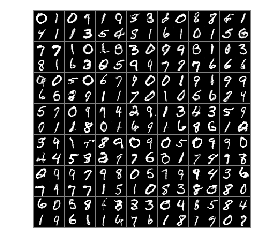

17500 0.57003903 1.16622 0.69892275 0.44115525
not training discriminator


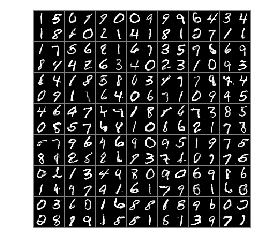

17550 0.551865 1.2834373 0.7247839 0.3789461
not training discriminator


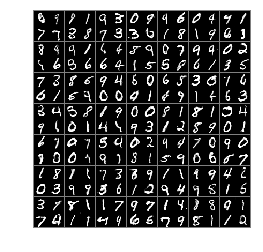

17600 0.57314473 1.2132244 0.7422532 0.4040363
not training discriminator


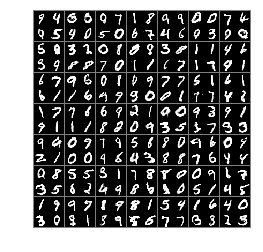

17650 0.5325673 1.2770553 0.66993654 0.39519823
not training discriminator


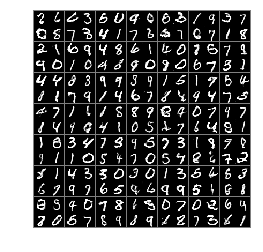

17700 0.54869884 1.1333998 0.628639 0.46875873
not training discriminator


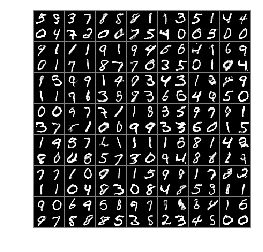

17750 0.57886726 0.72409666 0.38887447 0.7688601


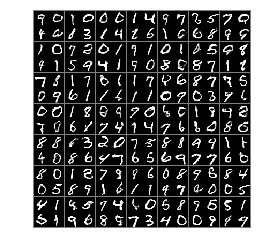

17800 0.5963429 1.1782821 0.7664799 0.42620587


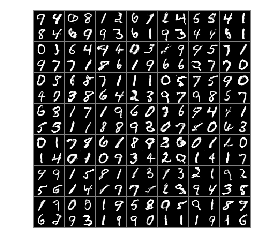

17850 0.5729761 1.3744293 0.81194633 0.33400583
not training discriminator


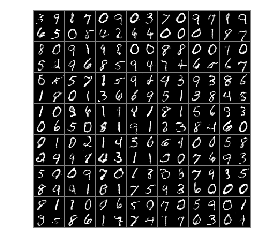

17900 0.5789161 0.664692 0.29624406 0.861588


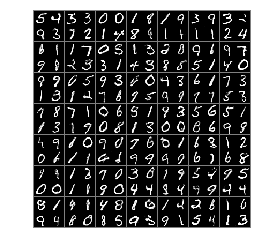

17950 0.5377888 1.0440466 0.57884043 0.49673712


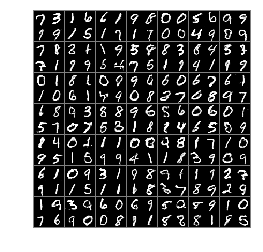

18000 0.6254144 1.4160116 0.93347275 0.31735608
not training discriminator


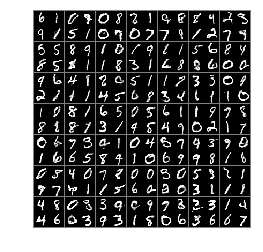

18050 0.53866124 1.1616393 0.628148 0.4491745
not training discriminator


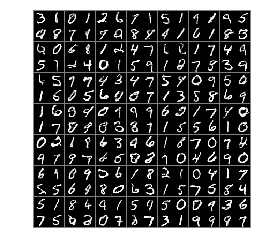

18100 0.58563125 1.2241678 0.78601897 0.38524356
not training discriminator


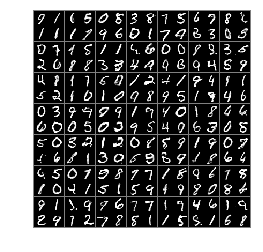

18150 0.5802363 1.2235737 0.76975703 0.39071566
not training discriminator


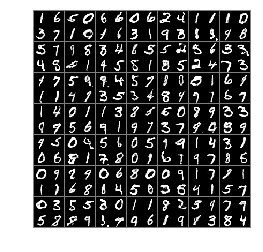

18200 0.5370397 1.6331862 0.8225112 0.25156823
not training discriminator


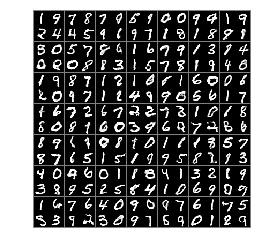

18250 0.56547195 0.7543648 0.38167876 0.7492651


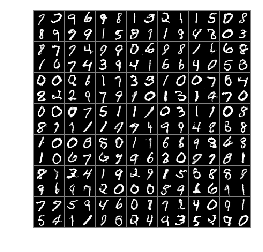

18300 0.6017848 1.4278449 0.88337165 0.32019797
not training discriminator


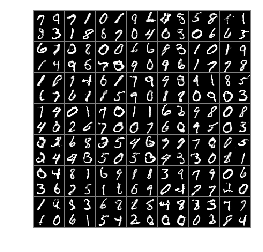

18350 0.53987485 0.94957143 0.51324767 0.56650203


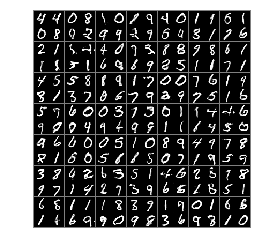

18400 0.53683436 1.177662 0.6579596 0.41570905
not training discriminator


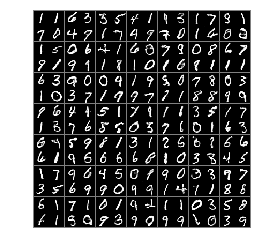

18450 0.6008535 1.3390517 0.8480968 0.3536102
not training discriminator


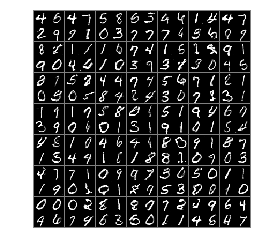

18500 0.5748287 1.2786261 0.7615934 0.3880639
not training discriminator


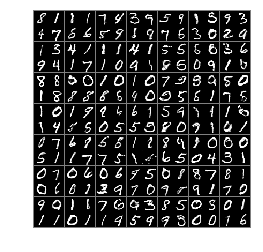

18550 0.587299 1.2612416 0.77716374 0.39743435
not training discriminator


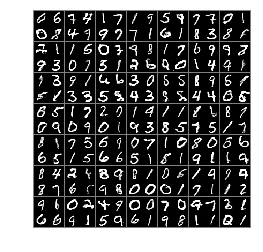

18600 0.5697341 0.7291643 0.38264233 0.756826


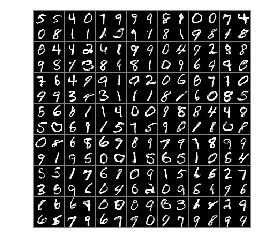

18650 0.5750296 1.266964 0.7589712 0.39108795
not training discriminator


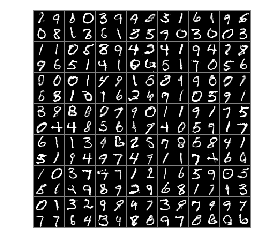

18700 0.5342848 1.1188613 0.6075645 0.461005
not training discriminator


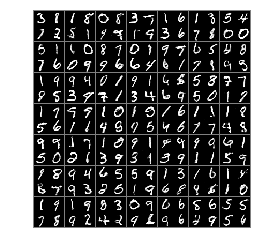

18750 0.5846547 1.3157586 0.7863431 0.38296634
not training discriminator


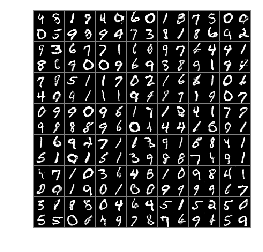

18800 0.57288605 1.2611105 0.76912564 0.37664646
not training discriminator


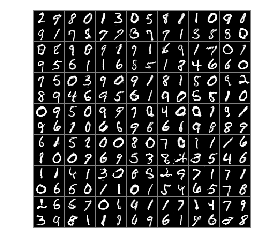

18850 0.5999791 1.1859787 0.76423186 0.43572646


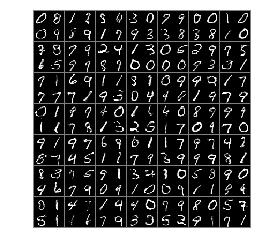

18900 0.5513333 1.2960311 0.745754 0.35691258
not training discriminator


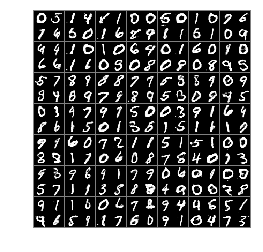

18950 0.5714107 1.3264769 0.78078604 0.3620355
not training discriminator


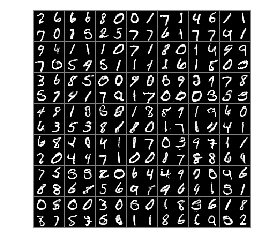

19000 0.52699465 1.4232991 0.73789334 0.3160961
not training discriminator


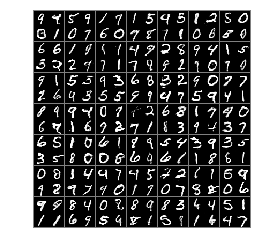

19050 0.5462716 1.0944673 0.6250222 0.46752104
not training discriminator


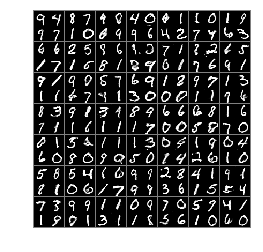

19100 0.5829519 1.2841283 0.7729442 0.3929596
not training discriminator


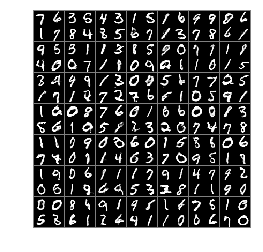

19150 0.5287104 1.4406852 0.74238515 0.31503567
not training discriminator


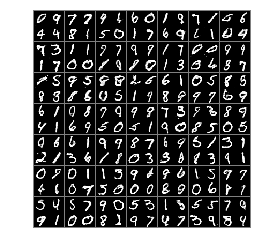

19200 0.5983466 1.3892272 0.8656357 0.33105734
not training discriminator


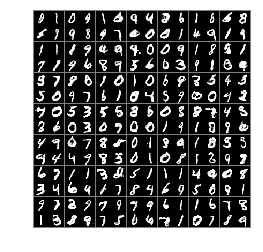

19250 0.55441326 1.2223837 0.6969927 0.41183397
not training discriminator


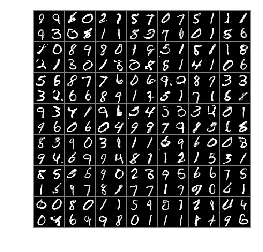

19300 0.56683517 1.3445617 0.78250885 0.35116157
not training discriminator


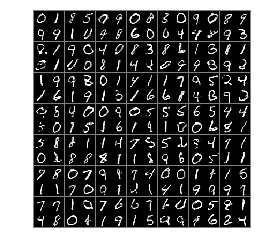

19350 0.61195815 1.304007 0.8248386 0.39907774
not training discriminator


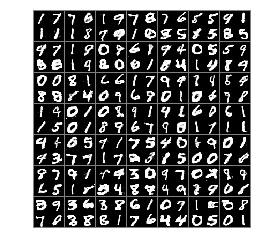

19400 0.6128658 1.1495765 0.7944487 0.43128276


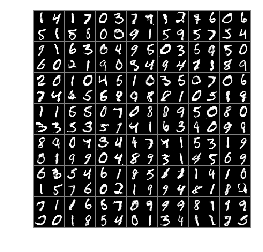

19450 0.65978724 1.6232678 1.0552562 0.26431826
not training discriminator


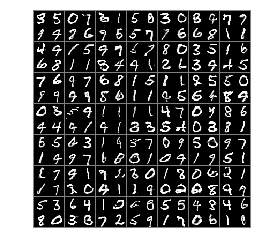

19500 0.55166423 0.72729266 0.34821117 0.7551173


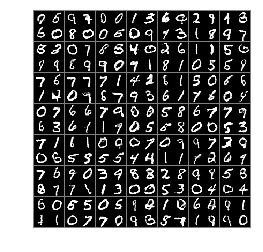

19550 0.59079343 1.2525252 0.77497834 0.4066085
not training discriminator


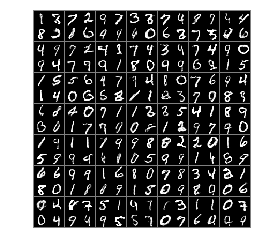

19600 0.6076615 1.6225017 0.96120477 0.25411826
not training discriminator


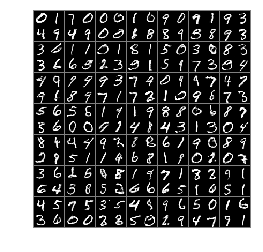

19650 0.5538852 1.4779615 0.79778755 0.30998284
not training discriminator


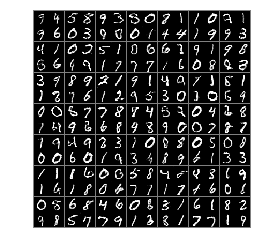

19700 0.5532398 1.1670657 0.69234616 0.4141335
not training discriminator


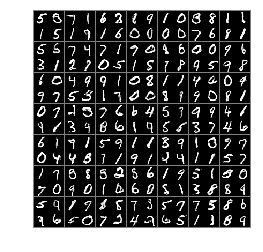

19750 0.5504253 0.9349713 0.54217005 0.5586806


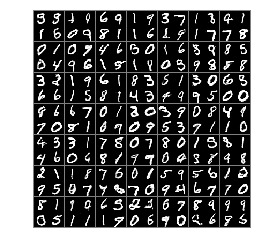

19800 0.6230285 0.7103859 0.41242272 0.8336344


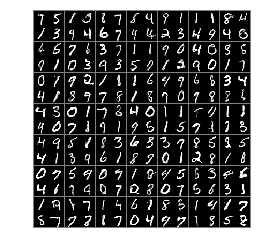

19850 0.57712996 1.1637383 0.73412466 0.42013523
not training discriminator


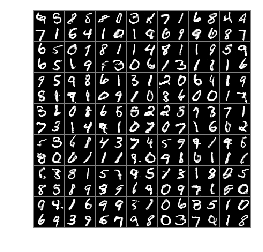

19900 0.55587256 1.3570124 0.77422357 0.33752152
not training discriminator


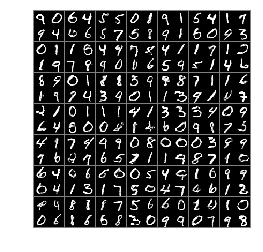

19950 0.5378656 1.2820504 0.6807365 0.39499474
not training discriminator


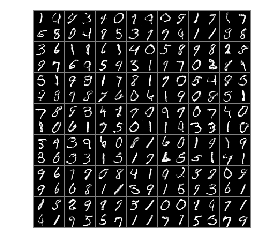

20000 0.542117 1.1604568 0.6409117 0.44332224
not training discriminator


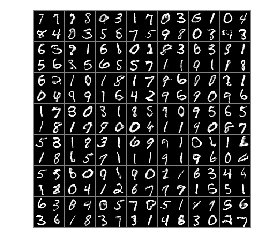

20050 0.6371652 1.3938216 0.9417449 0.33258554
not training discriminator


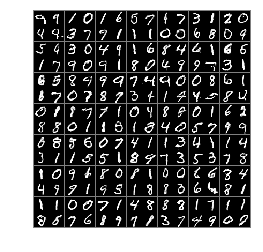

20100 0.59697384 1.2331234 0.78314054 0.41080716
not training discriminator


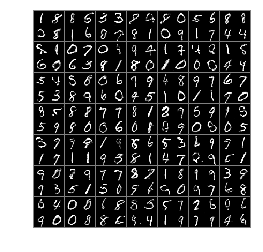

20150 0.584488 1.3167764 0.81604606 0.35292986
not training discriminator


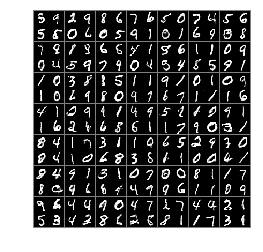

20200 0.5050479 1.2417555 0.61828893 0.39180684
not training discriminator


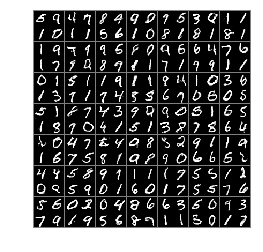

20250 0.58524007 1.3465205 0.812841 0.35763922
not training discriminator


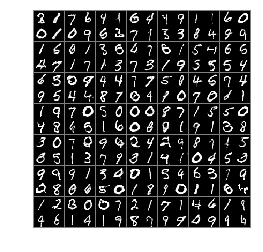

20300 0.5963171 1.2544193 0.79167515 0.4009591
not training discriminator


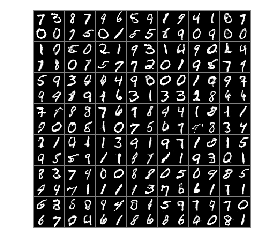

20350 0.574491 1.2274936 0.7347306 0.4142516
not training discriminator


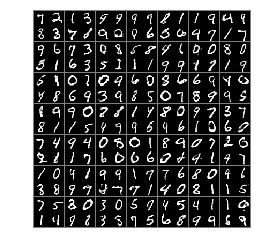

20400 0.6612612 1.2123381 0.9303166 0.39220592


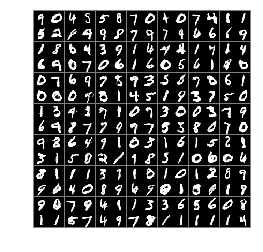

20450 0.56895614 1.4475287 0.8186524 0.31925985
not training discriminator


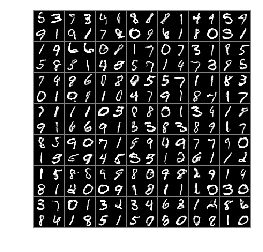

20500 0.5416475 1.3175615 0.73160726 0.35168776
not training discriminator


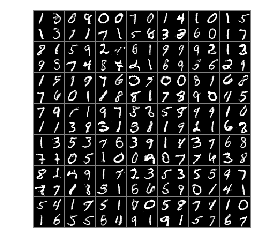

20550 0.5477158 1.1778038 0.67472464 0.42070693
not training discriminator


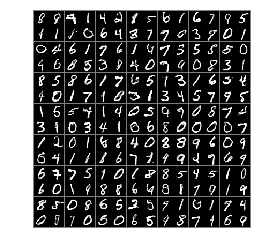

20600 0.57821965 1.1913309 0.7218384 0.43460095
not training discriminator


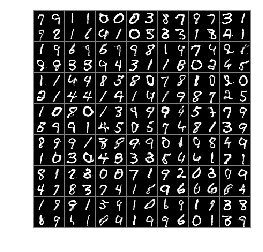

20650 0.56105477 1.1721306 0.6853238 0.43678594
not training discriminator


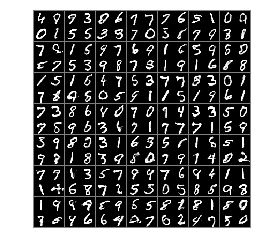

20700 0.5471917 1.0671204 0.59740984 0.49697363


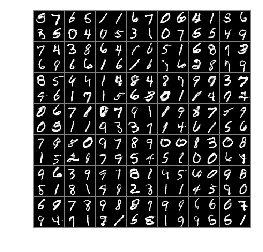

20750 0.5573182 1.1286345 0.6296672 0.48496908
not training discriminator


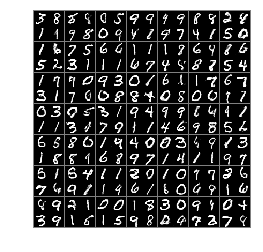

20800 0.6669568 1.5563082 1.0386695 0.2952439
not training discriminator


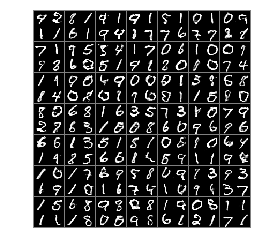

20850 0.5850291 1.3067963 0.82083464 0.34922355
not training discriminator


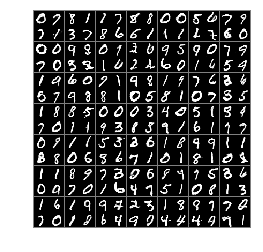

20900 0.60927016 1.7639437 1.001878 0.21666235
not training discriminator


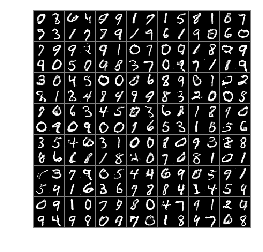

20950 0.60176057 0.6798301 0.37863994 0.8248812


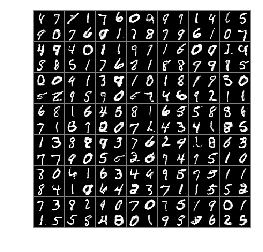

21000 0.5974288 1.2724397 0.8121327 0.38272488
not training discriminator


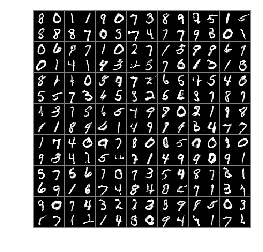

21050 0.61214066 1.5628381 0.9327097 0.29157156
not training discriminator


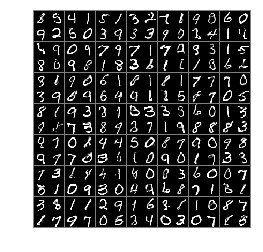

21100 0.62789786 1.3559233 0.89261025 0.36318535
not training discriminator


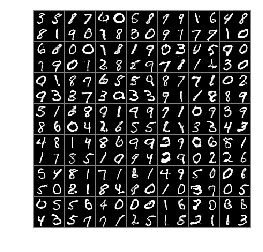

21150 0.5832526 1.1875294 0.7465152 0.41999006
not training discriminator


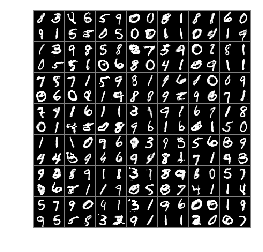

21200 0.56240636 1.2854738 0.7446507 0.38016215
not training discriminator


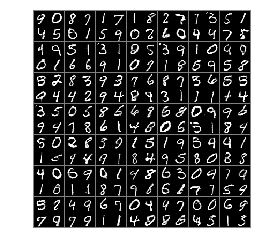

21250 0.5622913 1.2293787 0.7359507 0.38863194
not training discriminator


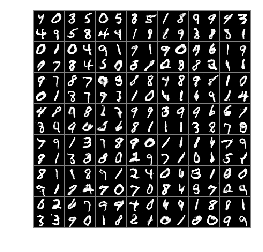

21300 0.61441684 0.6449427 0.34493482 0.88389874


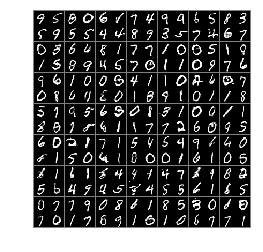

21350 0.5845583 1.2719721 0.7840572 0.38505945
not training discriminator


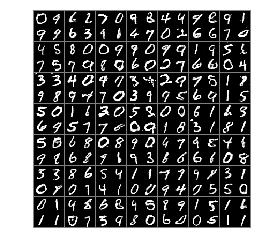

21400 0.61277336 1.3688294 0.8860299 0.3395168
not training discriminator


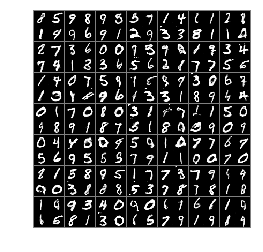

21450 0.5785452 1.3897848 0.8053586 0.35173187
not training discriminator


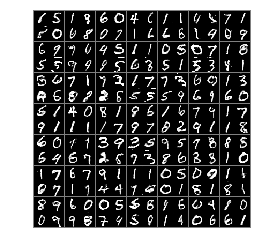

21500 0.5179026 1.2556694 0.65266144 0.38314384
not training discriminator


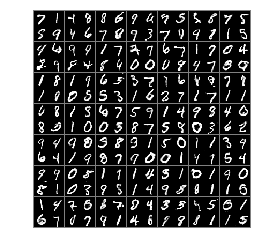

21550 0.63101786 1.4816489 0.96409374 0.297942
not training discriminator


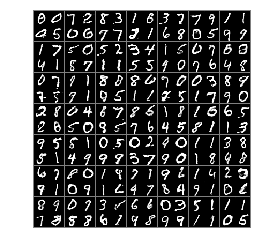

21600 0.6233867 1.538157 0.9543703 0.29240292
not training discriminator


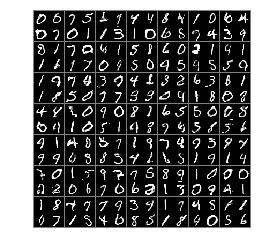

21650 0.4914076 1.0732278 0.50087076 0.48194444
not training discriminator


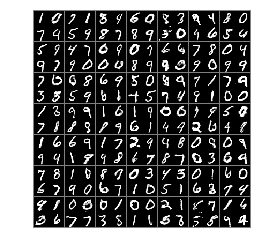

21700 0.6097496 1.418169 0.90473485 0.31476438
not training discriminator


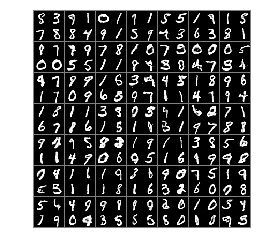

21750 0.59796834 1.2509859 0.80057824 0.3953584
not training discriminator


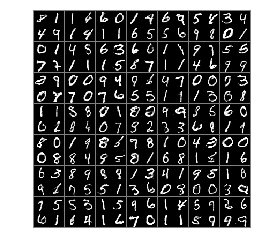

21800 0.550924 1.3005418 0.7297757 0.37207234
not training discriminator


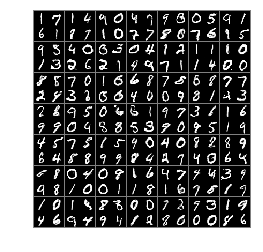

21850 0.5967398 1.4501216 0.8941071 0.29937273
not training discriminator


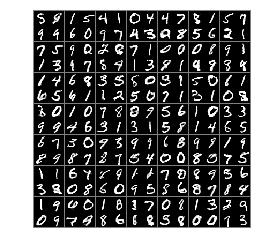

21900 0.5769747 1.2246113 0.74941736 0.404532
not training discriminator


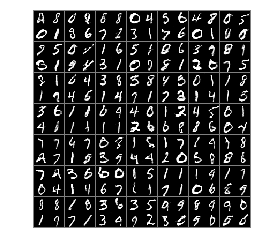

21950 0.4953041 1.1967238 0.58054227 0.41006598
not training discriminator


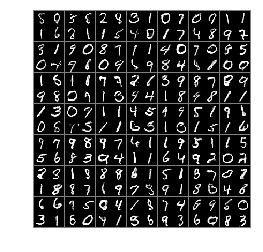

22000 0.57745683 1.2497864 0.75895363 0.39595997
not training discriminator


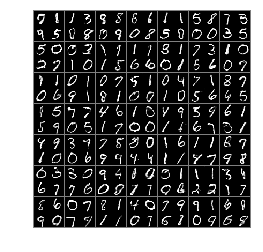

22050 0.6090228 1.6750865 0.97917205 0.23887362
not training discriminator


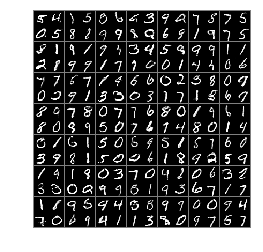

22100 0.61392856 1.28865 0.8577542 0.3701031
not training discriminator


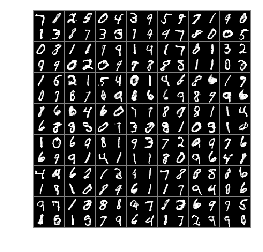

22150 0.53875345 1.1718253 0.6405808 0.4369261
not training discriminator


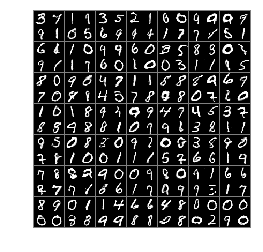

22200 0.5134415 1.0868998 0.5598068 0.4670762
not training discriminator


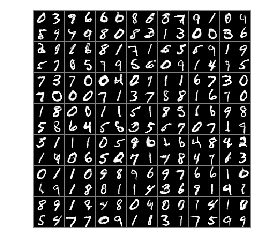

22250 0.5318081 1.1257433 0.6229162 0.4407
not training discriminator


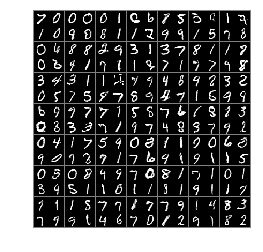

22300 0.68216854 1.2824423 0.9512204 0.41311657


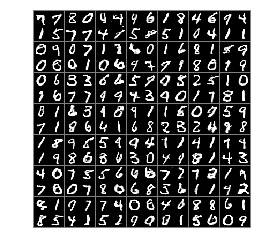

22350 0.5212718 0.88211435 0.4260841 0.6164596


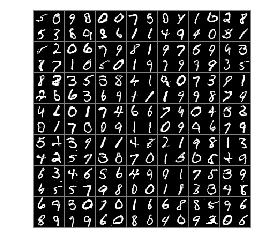

22400 0.63685113 1.3376522 0.92493874 0.34876353
not training discriminator


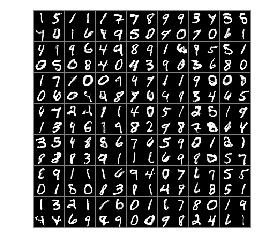

22450 0.58305585 1.3794656 0.8025667 0.363545
not training discriminator


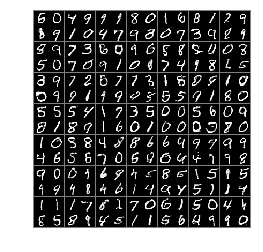

22500 0.5232918 1.2427871 0.66280675 0.3837769
not training discriminator


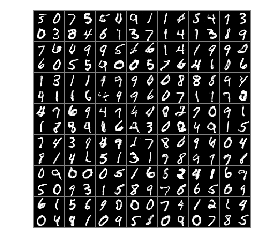

22550 0.5745408 0.7755648 0.42976543 0.7193162


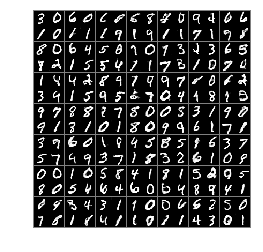

22600 0.59328276 1.4125266 0.8434881 0.34307745
not training discriminator


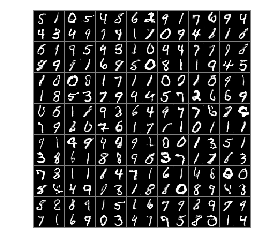

22650 0.5269164 1.1628517 0.6258127 0.42802
not training discriminator


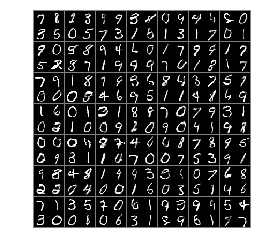

22700 0.5246171 1.3376255 0.69648594 0.35274827
not training discriminator


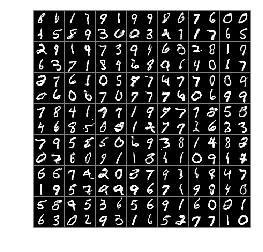

22750 0.5284697 0.9559412 0.5121258 0.5448136


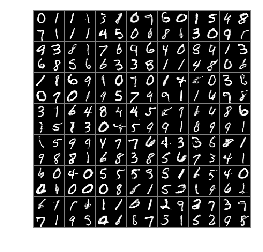

22800 0.64390194 1.3075199 0.9221853 0.36561874
not training discriminator


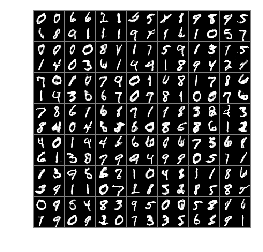

22850 0.56632763 1.2877676 0.7431437 0.38951153
not training discriminator


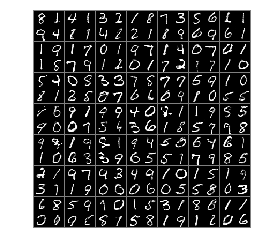

22900 0.60937023 1.316564 0.85344744 0.36529315
not training discriminator


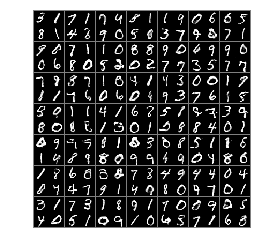

22950 0.58802736 1.2850875 0.80294394 0.37311083
not training discriminator


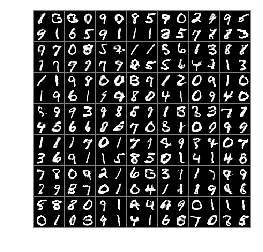

23000 0.55684376 1.1583484 0.6909942 0.4226934
not training discriminator


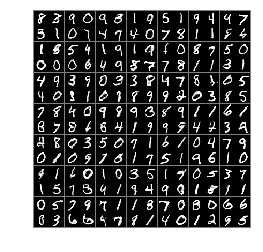

23050 0.54221857 1.0372896 0.5956539 0.4887833


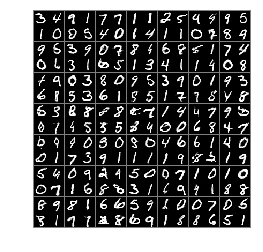

23100 0.6642357 0.5209527 0.28098294 1.0474883


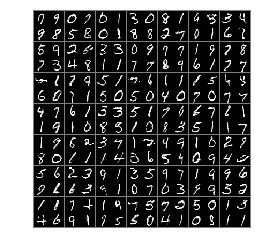

23150 0.5653278 1.2932383 0.75988114 0.37077436
not training discriminator


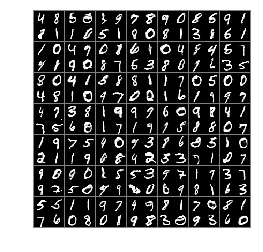

23200 0.6032683 1.177761 0.72155905 0.48497772


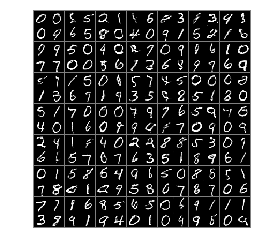

23250 0.61590964 1.400834 0.88988477 0.34193435
not training discriminator


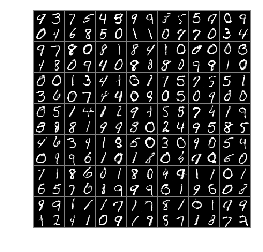

23300 0.5236179 0.93887067 0.45369607 0.5935398


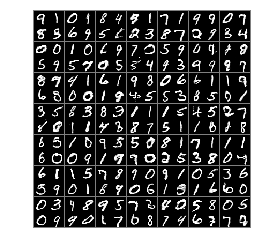

23350 0.50208443 1.1779286 0.57121193 0.432957
not training discriminator


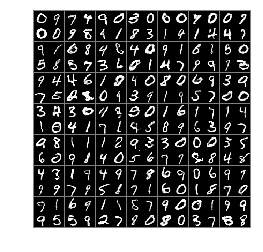

23400 0.55793613 1.3900877 0.7801844 0.335688
not training discriminator


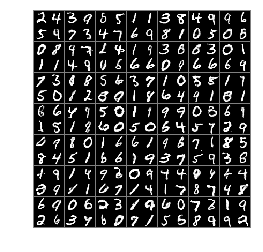

23450 0.6471526 1.6451364 1.0444307 0.24987447
not training discriminator


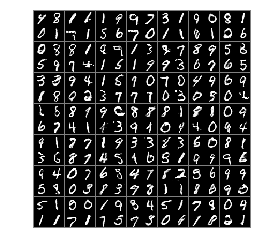

23500 0.52141 1.2562412 0.6529182 0.3899017
not training discriminator


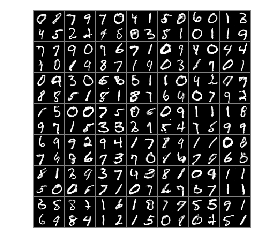

23550 0.55660653 1.2495655 0.7190963 0.3941167
not training discriminator


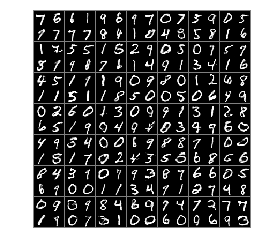

23600 0.552052 1.3290954 0.7340393 0.3700648
not training discriminator


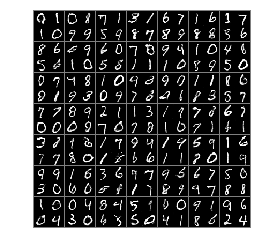

23650 0.6560433 1.4886469 1.017421 0.29466563
not training discriminator


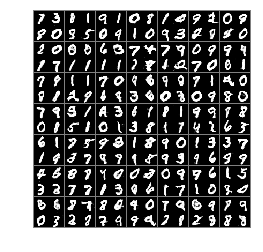

23700 0.6092843 1.5781026 0.9446099 0.27395862
not training discriminator


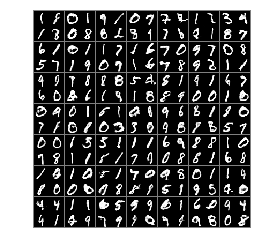

23750 0.5047481 1.0502876 0.51028115 0.49921504
not training discriminator


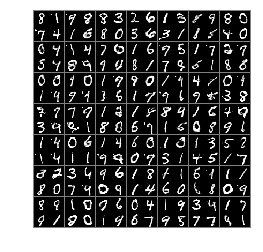

23800 0.56896245 1.6528956 0.8814735 0.25645146
not training discriminator


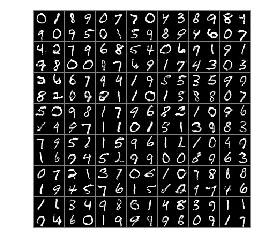

23850 0.54181325 1.1518949 0.649503 0.43412375
not training discriminator


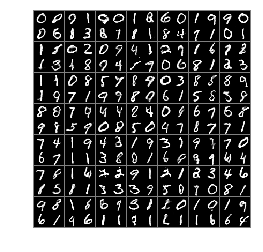

23900 0.5634339 0.9019327 0.49369726 0.6331706


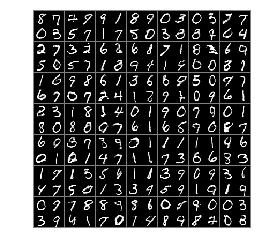

23950 0.51563144 1.438597 0.70762354 0.32363942
not training discriminator


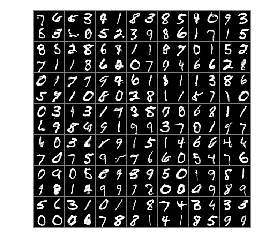

24000 0.52405804 1.0586641 0.5702731 0.47784293
not training discriminator


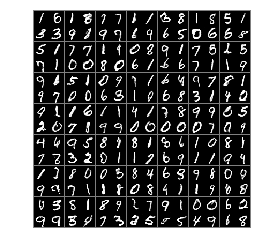

24050 0.56961304 1.4070517 0.8192136 0.3200124
not training discriminator


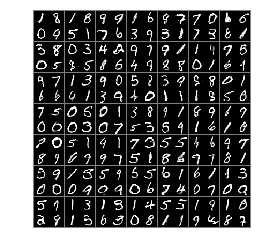

24100 0.5734692 0.89370847 0.49659038 0.65034795


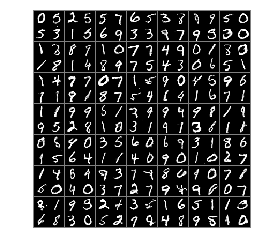

24150 0.5920485 1.1471299 0.7240759 0.46002117


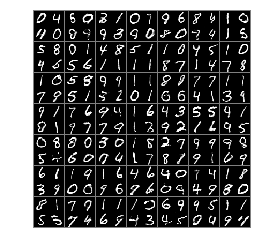

24200 0.58425564 1.359316 0.8369118 0.33159932
not training discriminator


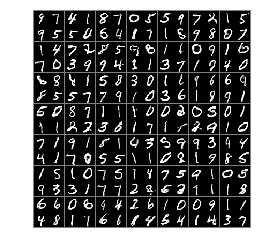

24250 0.5357625 1.0318761 0.56383777 0.5076871


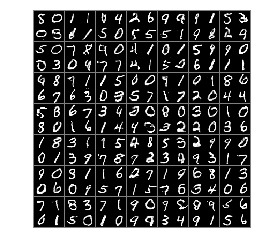

24300 0.6189548 1.5935055 0.97894317 0.25896636
not training discriminator


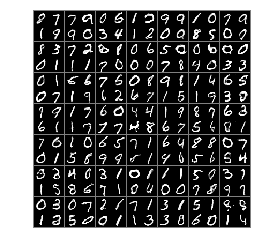

24350 0.56476164 1.2141325 0.70366055 0.42586276
not training discriminator


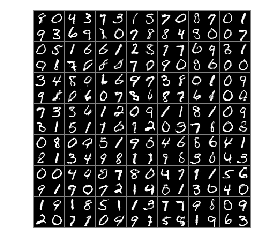

24400 0.69589376 1.3187963 1.0270224 0.36476505


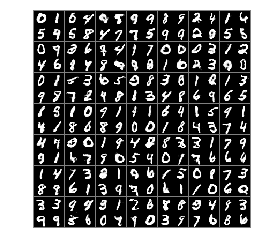

24450 0.5184461 1.0223789 0.53126025 0.5056319


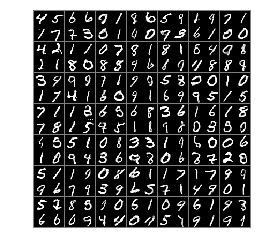

24500 0.5882762 1.1843156 0.72689974 0.44965276
not training discriminator


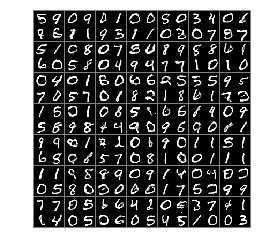

24550 0.53261775 1.2376409 0.6735222 0.39171332
not training discriminator


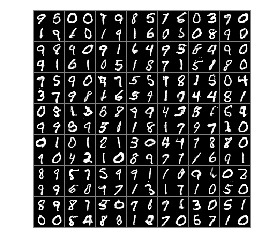

24600 0.5456034 0.83390015 0.41604063 0.67516625


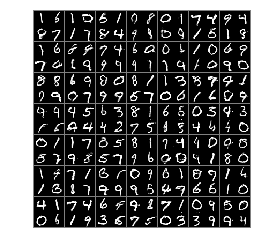

24650 0.6008529 1.4608191 0.89607054 0.30563524
not training discriminator


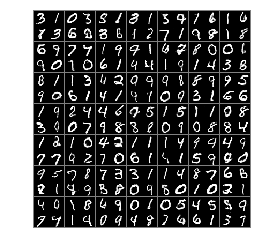

24700 0.56243247 1.1406134 0.6797509 0.44511405
not training discriminator


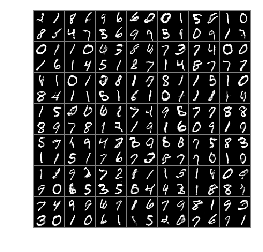

24750 0.50556767 1.0478811 0.5164571 0.4946781
not training discriminator


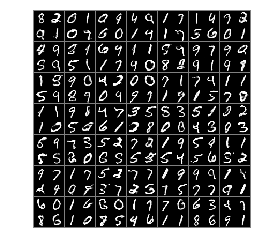

24800 0.60805756 1.6543105 0.96583736 0.25027776
not training discriminator


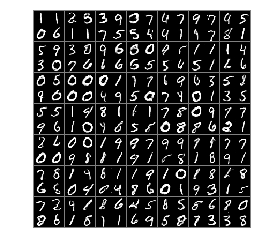

24850 0.5474254 1.1383617 0.619418 0.47543263
not training discriminator


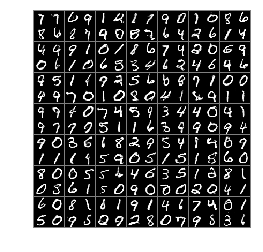

24900 0.56618214 1.2111112 0.7147258 0.41763848
not training discriminator


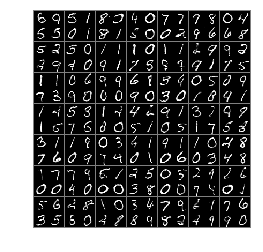

24950 0.6498935 1.5063139 1.0192786 0.2805084
not training discriminator


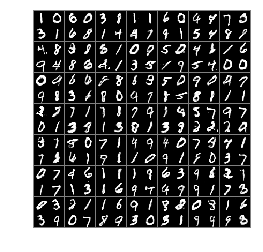

25000 0.6141181 1.2795299 0.82243687 0.40579936
not training discriminator


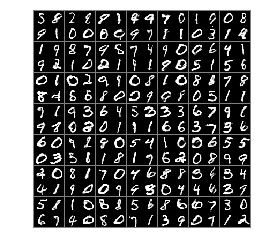

25050 0.58563805 1.3184204 0.8080379 0.36323804
not training discriminator


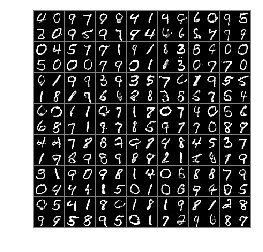

25100 0.60647845 1.5625056 0.94443846 0.26851845
not training discriminator


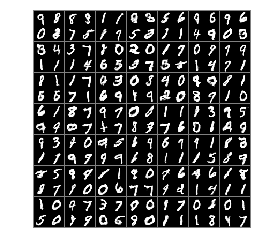

25150 0.532539 1.2143364 0.6657969 0.39928108
not training discriminator


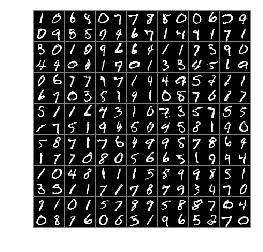

25200 0.6815518 1.9065644 1.1698091 0.19329445
not training discriminator


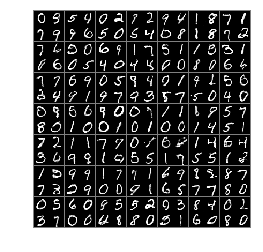

25250 0.5274869 1.2157589 0.6496013 0.40537253
not training discriminator


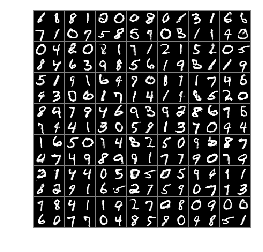

25300 0.7910069 1.5460606 1.2938089 0.28820476


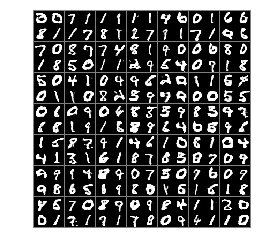

25350 0.56452423 1.319818 0.75811064 0.37093765
not training discriminator


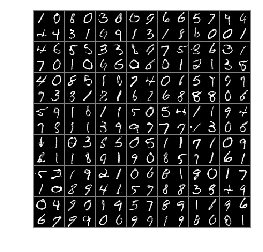

25400 0.5822996 1.281256 0.76773906 0.39686015
not training discriminator


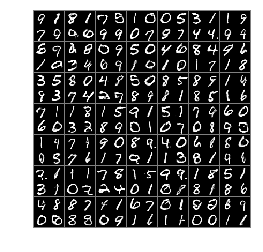

25450 0.6218562 1.2437757 0.8614685 0.38224387
not training discriminator


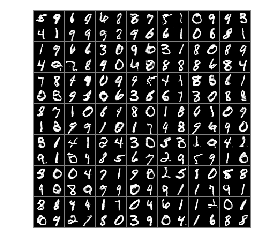

25500 0.5803708 1.3345438 0.79295987 0.3677816
not training discriminator


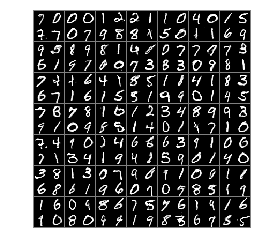

25550 0.61821604 0.6854508 0.41414654 0.8222854


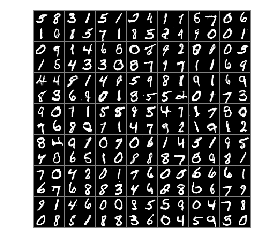

25600 0.5916411 1.3143678 0.795441 0.3878413
not training discriminator


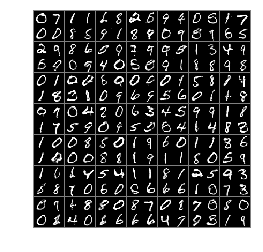

25650 0.610401 1.3265736 0.86483985 0.355962
not training discriminator


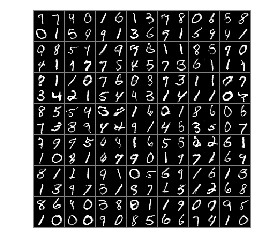

25700 0.5565599 0.8472742 0.4780704 0.6350495


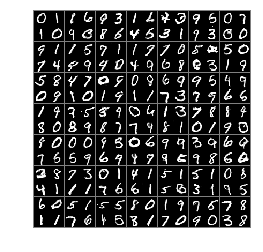

25750 0.6357289 1.845158 1.0461328 0.22532502
not training discriminator


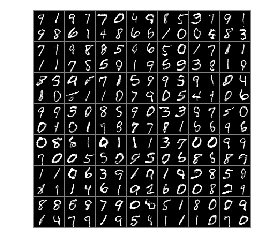

25800 0.5252914 0.8526863 0.4326847 0.617898


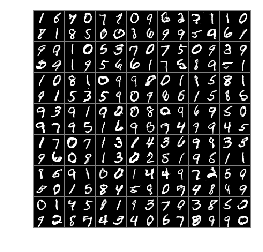

25850 0.6086115 1.5294037 0.92494965 0.29227337
not training discriminator


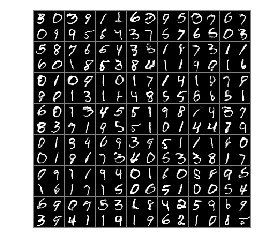

25900 0.59336996 1.4288006 0.858106 0.32863396
not training discriminator


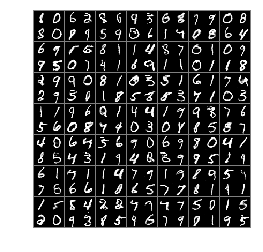

25950 0.6548887 1.261282 0.8669488 0.4428285


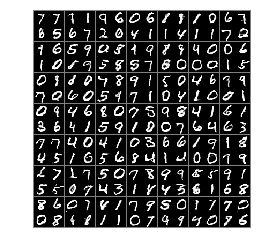

26000 0.6350672 1.3151667 0.8827889 0.38734546
not training discriminator


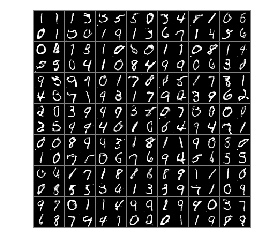

26050 0.54880905 1.204172 0.6742541 0.4233639
not training discriminator


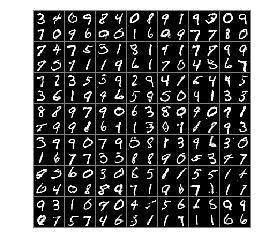

26100 0.5953483 1.4476649 0.88043463 0.31026214
not training discriminator


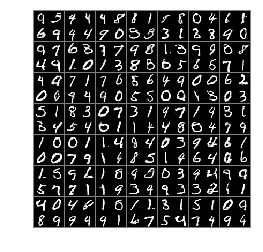

26150 0.6072636 1.5239538 0.91551733 0.29901004
not training discriminator


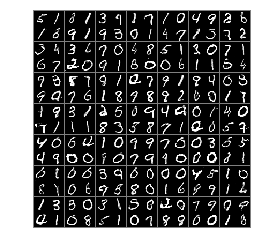

26200 0.52903575 1.2085345 0.6319133 0.42615816
not training discriminator


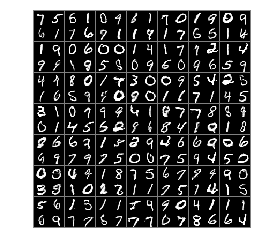

26250 0.48962855 1.1690515 0.5413619 0.43789524
not training discriminator


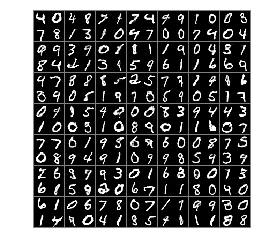

26300 0.78044045 2.1038408 1.4047693 0.15611154
not training discriminator


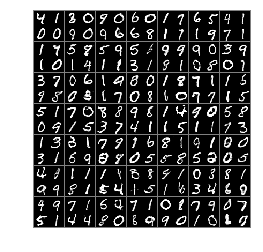

26350 0.544182 1.1963272 0.6605028 0.42786127
not training discriminator


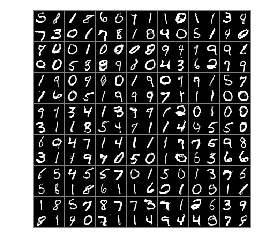

26400 0.56960845 1.7291381 0.89298993 0.2462269
not training discriminator


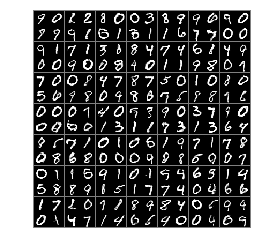

26450 0.52700466 1.1414402 0.6068865 0.44712287
not training discriminator


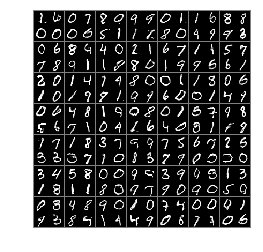

26500 0.615791 1.1875908 0.79520446 0.4363776


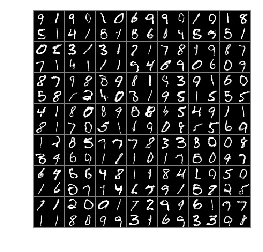

26550 0.56908804 1.4374017 0.83043855 0.30773756
not training discriminator


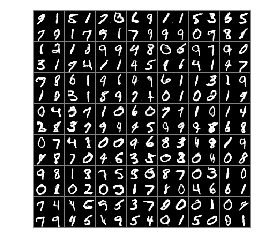

26600 0.5719647 1.2049868 0.72951186 0.41441742
not training discriminator


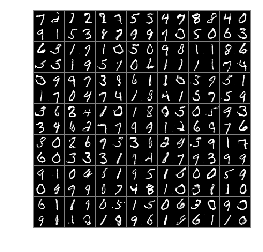

26650 0.5791158 0.6860431 0.34157717 0.8166546


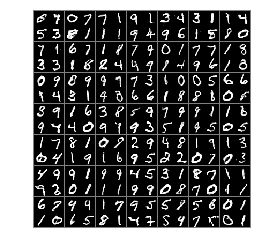

26700 0.5545144 0.9765414 0.5425131 0.5665158


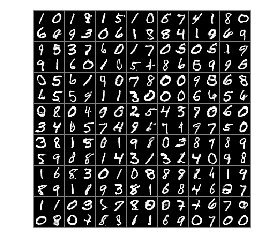

26750 0.5859146 1.3434774 0.8341837 0.33764562
not training discriminator


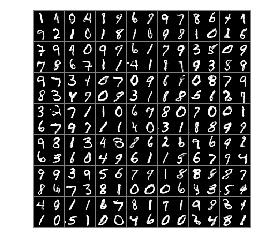

26800 0.5377926 1.369095 0.7346374 0.34094787
not training discriminator


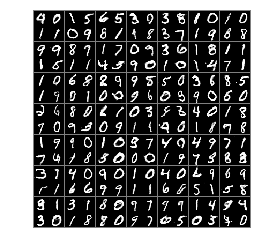

26850 0.5737598 1.1863999 0.69996256 0.44755694
not training discriminator


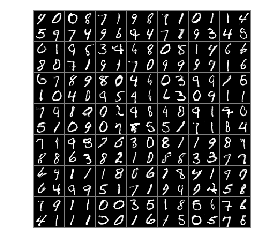

26900 0.5638612 1.293697 0.72774565 0.39997676
not training discriminator


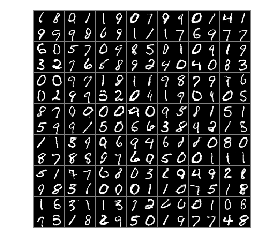

26950 0.5319529 1.1198976 0.5993041 0.46460173
not training discriminator


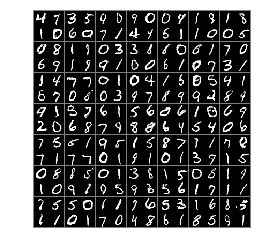

27000 0.6186359 1.2056724 0.8079249 0.4293468


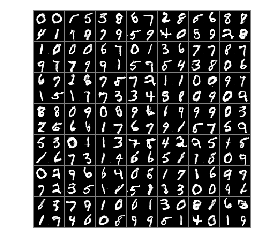

27050 0.5734007 1.4506407 0.81671345 0.33008796
not training discriminator


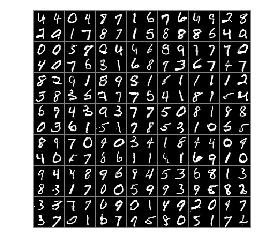

27100 0.58136904 0.67857814 0.34472018 0.8180179


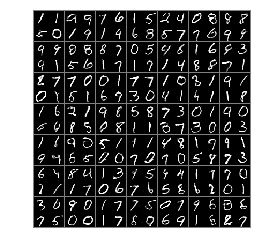

27150 0.57133734 1.2164812 0.7196223 0.42305234
not training discriminator


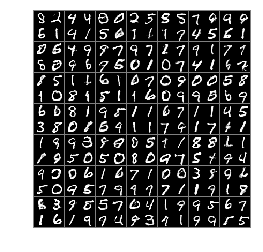

27200 0.58475214 1.2889043 0.8153484 0.35415578
not training discriminator


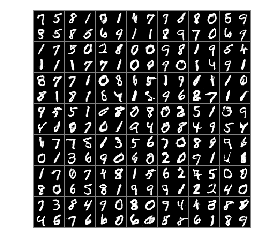

27250 0.57199866 1.2956197 0.76079607 0.3832012
not training discriminator


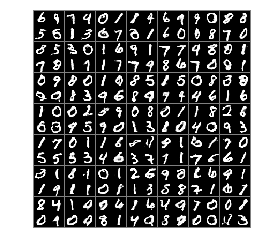

27300 0.55167055 1.4739956 0.7843267 0.3190145
not training discriminator


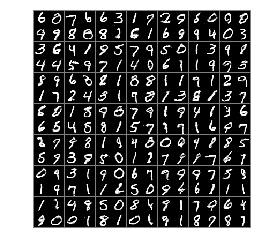

27350 0.62663406 1.2437348 0.8607363 0.3925318


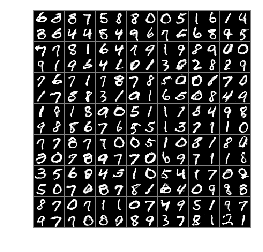

27400 0.53507495 1.0031724 0.5432184 0.52693146


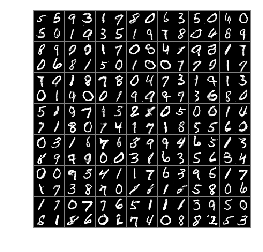

27450 0.5588455 1.2984537 0.7306405 0.38705072
not training discriminator


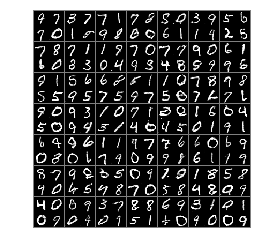

27500 0.62250066 1.2434087 0.85279596 0.3922052


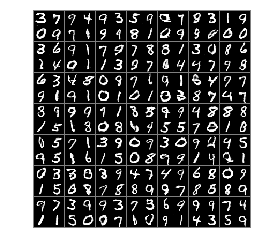

27550 0.5182196 1.2938231 0.667924 0.36851528
not training discriminator


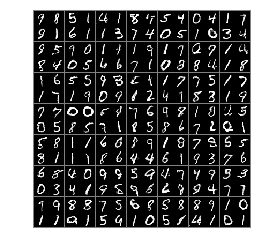

27600 0.65728194 1.4167091 1.0025359 0.31202796
not training discriminator


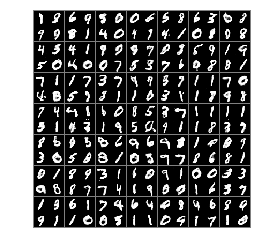

27650 0.5351225 1.2288687 0.6617623 0.4084827
not training discriminator


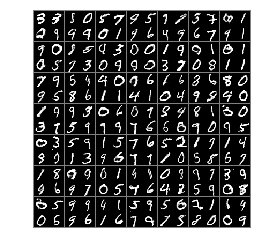

27700 0.5710586 1.2609121 0.7520435 0.39007357
not training discriminator


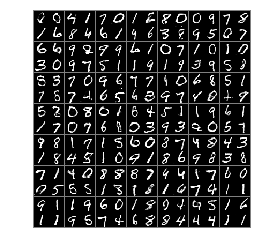

27750 0.55547845 1.2515213 0.72241443 0.3885424
not training discriminator


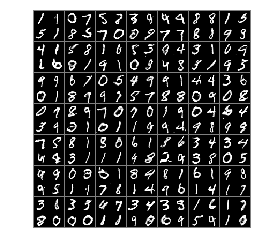

27800 0.65046746 1.2992151 0.8680492 0.43288562


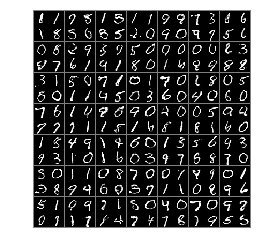

27850 0.60148233 1.492301 0.906724 0.29624057
not training discriminator


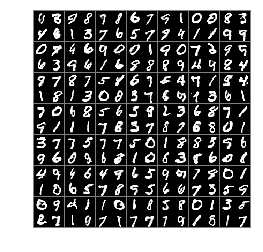

27900 0.54712903 1.3783728 0.7448164 0.34944168
not training discriminator


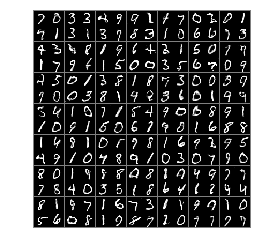

27950 0.55972654 0.8346989 0.44317552 0.67627764


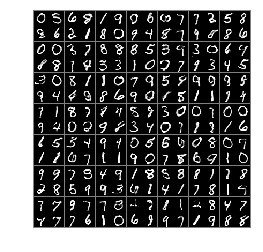

28000 0.556097 1.3370731 0.7666226 0.3455714
not training discriminator


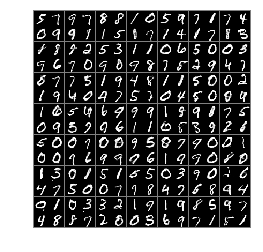

KeyboardInterrupt: 

In [9]:
main()

Voila! We have successfully created a Generative Adversarial Network for image data set. There are a lot of capabilities of this network, although our network is too small to be a deep neural network but still we are getting very good results out of our generator.

So we got a generator which can generate digits for us. We are calling it successful because we can see it can generate similar digits as present in the dataset. But  is this the only way to evaluate the performance of a GAN?

# Evaluation of GANs

The easiest way to evaluate the performance of the GAN is comparing the generated images with the real data by which our discriminator is trained. In case of digit classification, this is how our input data looks like;

<img src= 'GAN_4.png'>

and output of our generator looks something like this;

<img src= 'sample_162.0.jpg'>

Which is quite similar to the training data. This kind of evaluation is known as "Manual evaluation" which falls under the qualitative analysis category. This is the easiest and the fastest way of evaluation. But we all know we are in the field of analytics where numbers have more power than any other thing. So If we want to evaluate the performance of the trained generator we need to do some quantitative evaluation.

There are more than 20 ways to evaluate the GAN's performance. But if we will discuss about all of them, we will loose our track; So if your interested in learning about that you can refer [Pros and Cons of GAN Evaluation Measures](https://arxiv.org/abs/1802.03446). Right now we will discuss one most popular among them, **Inception Score**.

So without wasting our time let's understand how this one can help to evaluate the GAN's generator.

## Inception Score

Do you remember solving a maths problem in class 2? It was hard to describe man; and when you got the answer, your mom always tells you to show the result to your elder sibling to check whether your answer is correct or not. The same we do in here. 

You may recall Leonardo DiCaprio or Christopher Nolan when you heard the word Inception. But let me tell you this is not a movie but a CNN! Inception is one of the greatest architecture in the CNN family. It is referred as elder sibling of other CNNs of the family. Why? It was the first network which introduced the width in the network. Before inception all the CNN have depth in the architecture whether it is classic VGG with 16, 19 or 21 layers or resnet with more than 100 layers; all these networks grow depth wise, thats why it is known as the deep learning. Inception added concept of the spatial scale in addition with the depth based architecture. Following figure is a part of the inception network.

<img src = 'GAN_9.png' width=400>

As you can see in above figure, on the same level it have multiple convolution filters with different kernel size. This allows the network to learn about smaller and larger objects at the same time. This is known as scale space. To know more about the inception network refer to the paper [“Rethinking the Inception Architecture for Computer Vision.”](https://arxiv.org/abs/1512.00567)

Okay we have talk enough about the inception architecture, now back to the business. As this network have wonderful architecture, it holds one of the best accuracy score (>78%) for the imagenet data set. So what? Well the basic idea here is; if we pass the images generated by the generator to the network for classification and If it correctly classifies them, then hurray! If we can fool the inception than we can fool anyone!

So Inception score is a metric derived from inception architecture. Inception Score or IS is calculated using class probabilities generated at the networks last layer (Softmax). IS gives us two properties;

- Image Quality
- Image Diversity

Here **Image Quality** is directly referred to how well the generator generates the images. And **Image Diversity** tells us how different kind of images the network can generate.

Now let's talk about some boring stuff about the Inception score, It is required to understand how Inception score is calculated; So please bear with me. So let's make some theoretical basis for going ahead. 

Whenever we use softmax activation in the last layer of a network, the output is always in the form of conditional probabilities. So when any class is classified with very high probability (>0.7) this indicates a high quality output as class probabilities are diverse in such cases. This is also known as low entropy system as classifier is able to easily predict the class id of the image. If the classifier struggles in class prediction, such systems have high entropy. So we can settle here, If a classification system have Low entropy, it is easy for it to predict classes while it is opposite in case of High entropy system.

The entropy is calculated as the negative sum of each observed probability multiplied by the log of the probability. The intuition here is that large probabilities have less information than small probabilities.

\begin{align} entropy = -\sum(p_i * \log(p_i)) \end{align}

The conditional probability captures our interest in **image quality**. If this entropy is low we have a very good classifier.

On the other hand marginal probability can help us to find out how well the classifier can classify variety of images. marginal probability is the probability distribution of all generated images. It is sum of all the probabilities. In case of marginal probabilities we always want a system with High entropy which shows how diversify the system is. We, therefore, would prefer the integral of the marginal probability distribution to have a high entropy. 

So now we have established the fact that to get a measurement of network's (GAN) performance, conditional probability distribution and marginal probability distribution can be used. Following figure will give you an idea about what I am talking;

<img src= 'GAN_10.png'>

*This image is taken from a [Medium article](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a) written by David Mack. It is a very good explanation of the process.*

As you can see when the classifier is very well in class discrimination it generates concentrated probability distribution on left side, this is the conditional probability distribution. While if we fed variety of images to the classifier and combines it generates a uniform probability distribution, which is the marginal probability distribution. As these two distributions are exactly opposite in nature, we can find out the difference between them, if difference is high we have a very good network (GAN) if score is low that means one of the above property is not satisfied and network is not performing well. So how will we achieve this?  

Well we can use Kullback-Leibler divergence or KL- Divergence to combine these two elements. KL divergence is used to find out divergence between two probability distributions. If divergence is low this means the distributions are quite similar and opposite in case of high divergence. To understand more about KL divergence follow this [Wikipedia](https://en.wikipedia.org/wiki/Kullback%E2%80%93Leibler_divergence) document. We can understand how the KL divergence can be a good measure for finding out difference between two distributions.

<img src='GAN_11.png'>

*This image is taken from a [Medium article](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a)*

The calculation of the inception score on a group of images involves first using the inception model to calculate the conditional probability for each image **(p(y|x))**. The marginal probability is then calculated as the average of the conditional probabilities for the images in the group **(p(y))**.

The KL divergence is then calculated for each image as the conditional probability multiplied by the log of the conditional probability minus the log of the marginal probability.

\begin{align} KLdivergence = p(y|x) * (\log(p(y|x))\ – \log(p(y))) \end{align}

The KL divergence is then summed over all images and averaged over all classes and the exponent of the result is calculated to give the final score.

That's it! this is how you can find out how well our GAN is performing. 

Now if you are wondering why I have not used IS for evaluation of our GAN; so let me tell you if we want to calculate the IS score, We will need an inception network trained on our digit data set and that will become out of context. So I am leaving it here only. 

# Summary

So what do you say? Can we generate fake tickets using a GAN? I will say; Hell Yes! we can create a GAN for generating fake tickets but it will need bit more complex architecture, we need to add some more convolution layers with more number of filters and a lot of training samples. So what’s next? Well my friends practice is the key to success. So go and open your jupyter notebook and start implementing your own GAN and keep learning.